In [1]:
import os
os.environ['KAGGLE_USERNAME'] = "elgafr"
os.environ['KAGGLE_KEY'] = "eab7df6985855888666f3b0f914674ec"

In [2]:
!kaggle kernels output shalordx/v2-final-ta-fix-amiin-ml-task -p /kaggle/working

In [3]:
# Cell 1 - Imports & constants
import os
from pathlib import Path
import json
import random
import shutil
import glob
import numpy as np
import pandas as pd
from tqdm import tqdm
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split, StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix
import joblib
import cv2
import tensorflow as tf
from tensorflow.keras import layers, models, optimizers, callbacks
tf.random.set_seed(42)
RANDOM_STATE = 42  # gunakan ini agar tidak error jika ter-restart

# Paths (sesuaikan ROOT jika perlu)
ROOT = Path("/kaggle/input/covidqu")
INFECTION_ROOT = ROOT / "Infection Segmentation Data" / "Infection Segmentation Data"
LUNG_ROOT = ROOT / "Lung Segmentation Data" / "Lung Segmentation Data"
ARTIFACTS = Path("./artifacts")
ARTIFACTS.mkdir(parents=True, exist_ok=True)
IMG_EXT = (".png", ".jpg", ".jpeg")
print("Infection root ->", INFECTION_ROOT)
print("Lung root      ->", LUNG_ROOT)

2025-11-04 03:18:14.125858: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1762226294.386652      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1762226294.458670      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


Infection root -> /kaggle/input/covidqu/Infection Segmentation Data/Infection Segmentation Data
Lung root      -> /kaggle/input/covidqu/Lung Segmentation Data/Lung Segmentation Data


In [4]:
# Cell 2 - scan folders and build metadata
def find_images_and_masks(base_dir: Path):
    rows = []
    # expected subfolders: Train/Val/Test each with class subfolders e.g. COVID-19, Non-COVID, Normal
    for split in ["Train", "Val", "Test", "train", "val", "test"]:
        split_dir = base_dir / split
        if not split_dir.exists():
            continue
        for class_dir in split_dir.iterdir():
            if not class_dir.is_dir():
                continue
            label = class_dir.name
            # images directory may be nested under 'images' sometimes
            images_folder_candidates = [class_dir, class_dir / "images"]
            for images_folder in images_folder_candidates:
                if not images_folder.exists():
                    continue
                for img in images_folder.iterdir():
                    if img.suffix.lower() in IMG_EXT:
                        # infection mask candidate is under .../infection masks/<same_filename>.png
                        inf_mask = class_dir / "infection masks" / img.name
                        # fallback: maybe mask under images parent 'infection masks' at same level
                        if not inf_mask.exists():
                            inf_mask = images_folder.parent / "infection masks" / img.name
                        rows.append({
                            "image_path": str(img),
                            "infection_mask_path": str(inf_mask) if inf_mask.exists() else None,
                            "label": label,
                            "split": split
                        })
    return pd.DataFrame(rows)

meta_path = ARTIFACTS / "metadata_infection.csv"
if meta_path.exists():
    meta = pd.read_csv(meta_path)
    print("Loaded metadata from", meta_path)
else:
    meta = find_images_and_masks(INFECTION_ROOT)
    meta.to_csv(meta_path, index=False)
    print("Saved metadata to", meta_path)

print("Total images found:", len(meta))
print("Label counts:")
print(meta['label'].value_counts(dropna=False))

Saved metadata to artifacts/metadata_infection.csv
Total images found: 5826
Label counts:
label
COVID-19     2913
Non-COVID    1457
Normal       1456
Name: count, dtype: int64


Mask coverage: 1.0


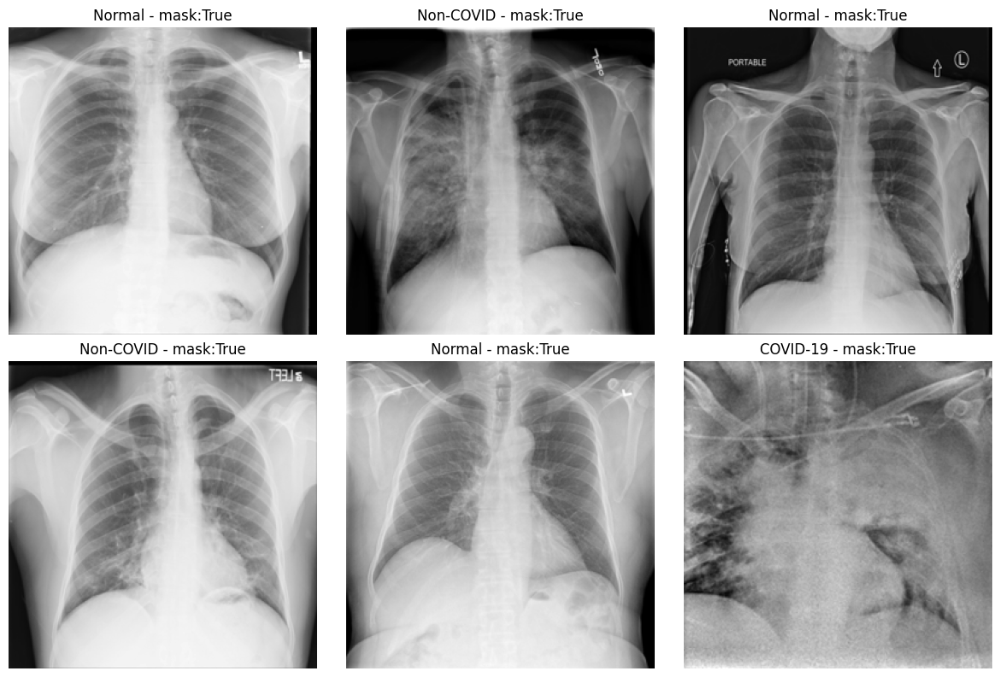

In [5]:
# Cell 3 - EDA & visualize few examples
def show_examples(meta_df, n=6):
    fig, axs = plt.subplots(n//3, 3, figsize=(12, 4 * (n//3)))
    axs = axs.flatten()
    examples = meta_df.sample(n, random_state=RANDOM_STATE)
    for ax, (_, row) in zip(axs, examples.iterrows()):
        img = cv2.imread(row['image_path'], cv2.IMREAD_GRAYSCALE)
        ax.imshow(img, cmap='gray')
        ax.set_title(f"{row['label']} - mask:{bool(row['infection_mask_path'])}")
        ax.axis('off')
    plt.tight_layout()

print("Mask coverage:", meta['infection_mask_path'].notnull().mean())
show_examples(meta, n=6)


In [6]:
# %%
# Cell 4 - Preprocessing functions (CLAHE + Normalization, NO MASKS)
TARGET_SIZE = (224, 224)  # for CNN and feature extraction

def load_image_raw_gray(path, size=TARGET_SIZE):
    """Load grayscale [0..255] uint8 + resize."""
    img = cv2.imread(path, cv2.IMREAD_GRAYSCALE)
    if img is None:
        raise FileNotFoundError(path)
    img = cv2.resize(img, size, interpolation=cv2.INTER_AREA)
    return img  # uint8 0..255

def apply_clahe(img_uint8, clipLimit=2.0, tileGridSize=(8, 8)):
    """Apply CLAHE pada citra grayscale uint8."""
    clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    eq = clahe.apply(img_uint8)
    return eq  # uint8 0..255

def normalize_image(img, method="minmax", zscore=False, eps=1e-7):
    """
    Normalisasi:
      - default: minmax ke [0,1]
      - jika zscore=True: (x - mean)/std lalu optional clip ke +/- 5 std dan rescale ke [0,1] bila perlu.
    """
    img = img.astype(np.float32)
    if zscore:
        m, s = img.mean(), img.std() + eps
        img = (img - m) / s
        # optional: clip agar tidak terlalu ekstrem saat visualisasi
        img = np.clip(img, -5, 5)
        # rescale ke [0,1] agar konsisten untuk penyimpanan/plot (opsional)
        img_min, img_max = img.min(), img.max()
        img = (img - img_min) / (img_max - img_min + eps)
        return img
    # minmax
    return img / 255.0

def preprocess_image(path,
                     size=TARGET_SIZE,
                     use_clahe=True,
                     clipLimit=2.0,
                     tileGridSize=(8, 8),
                     normalize=True,
                     zscore=False):
    """
    Pipeline final:
      1) load grayscale + resize (uint8)
      2) CLAHE (opsional)
      3) normalisasi → float32 [0,1] (atau zscore→rescale)
      4) return HxW (float32)
    """
    raw = load_image_raw_gray(path, size=size)
    proc = apply_clahe(raw, clipLimit, tileGridSize) if use_clahe else raw
    if normalize:
        proc = normalize_image(proc, method="minmax", zscore=zscore)
    return proc.astype(np.float32)

# Quick sanity check on satu sampel
_sample_path = meta.iloc[0]['image_path']
_raw = load_image_raw_gray(_sample_path)
_clahe = apply_clahe(_raw)
_final = preprocess_image(_sample_path)
print("Shapes → raw:", _raw.shape, "| final:", _final.shape, "| dtype:", _final.dtype,
      "| range ≈", (float(_final.min()), float(_final.max())))


Shapes → raw: (224, 224) | final: (224, 224) | dtype: float32 | range ≈ (0.003921568859368563, 0.9960784316062927)


🔎 Menampilkan & menyimpan contoh preprocessing (Original → CLAHE → Final)
💾 Disimpan grid: artifacts/viz_preproc/preproc_grid_CLAHE_N6_20251104-031835.png


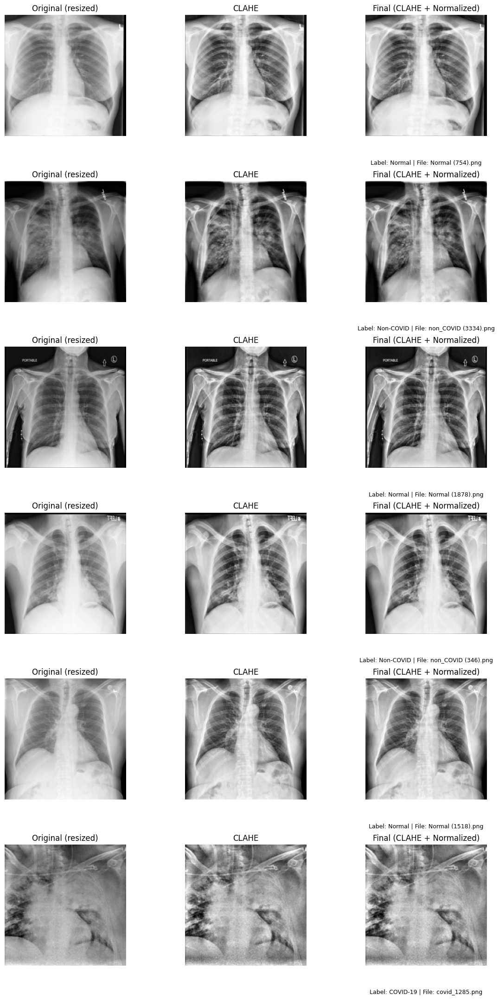

🗒️  Log CSV: artifacts/viz_preproc/preproc_log_CLAHE_N6_20251104-031835.csv


In [7]:
# %%
# Cell 4A - Visualisasi hasil preprocessing (Original → CLAHE → Final) + SAVE
from datetime import datetime

VIZ_DIR = ARTIFACTS / "viz_preproc"
VIZ_DIR.mkdir(parents=True, exist_ok=True)

# Konfigurasi default visualisasi
CLAHE_CLIP = 2.0
CLAHE_TILES = (8, 8)
USE_ZSCORE = False  # ubah ke True jika ingin z-score

def build_processed_no_mask(img_path):
    """Return (original_resized_uint8, clahe_uint8, final_float32_[0,1])"""
    raw = load_image_raw_gray(img_path, size=TARGET_SIZE)
    clahe = apply_clahe(raw, clipLimit=CLAHE_CLIP, tileGridSize=CLAHE_TILES)
    final = preprocess_image(
        img_path,
        size=TARGET_SIZE,
        use_clahe=True,
        clipLimit=CLAHE_CLIP,
        tileGridSize=CLAHE_TILES,
        normalize=True,
        zscore=USE_ZSCORE
    )
    return raw, clahe, final

def plot_triplet(axs_row, raw_u8, clahe_u8, final_f32, title=""):
    ax0, ax1, ax2 = axs_row
    ax0.imshow(raw_u8, cmap="gray")
    ax0.set_title("Original (resized)")
    ax0.axis("off")

    ax1.imshow(clahe_u8, cmap="gray")
    ax1.set_title("CLAHE")
    ax1.axis("off")

    ax2.imshow(final_f32, cmap="gray")
    ax2.set_title("Final (CLAHE + Normalized)")
    ax2.axis("off")

    if title:
        ax2.text(0.5, -0.22, title, ha="center", va="center",
                 transform=ax2.transAxes, fontsize=9)

def visualize_preproc_no_mask(meta_df, n=6, seed=RANDOM_STATE,
                              save_grid=True, save_individual=False):
    n = min(n, len(meta_df))
    rows = list(meta_df.sample(n, random_state=seed).itertuples())

    # logging
    log_rows = []
    ts = datetime.now().strftime("%Y%m%d-%H%M%S")

    # ====== GRID ======
    fig, axs = plt.subplots(n, 3, figsize=(12, 3.6*n))
    if n == 1:
        axs = np.expand_dims(axs, axis=0)
    for axrow, row in zip(axs, rows):
        raw_u8, clahe_u8, final_f32 = build_processed_no_mask(row.image_path)
        title = f"Label: {row.label} | File: {os.path.basename(row.image_path)}"
        plot_triplet(axrow, raw_u8, clahe_u8, final_f32, title=title)
        log_rows.append({
            "image_path": row.image_path,
            "label": row.label,
            "split": row.split,
            "basename": os.path.basename(row.image_path),
            "clahe_clip": CLAHE_CLIP,
            "clahe_tiles": f"{CLAHE_TILES[0]}x{CLAHE_TILES[1]}",
            "zscore": USE_ZSCORE,
            "timestamp": ts
        })
    plt.tight_layout()
    if save_grid:
        grid_path = VIZ_DIR / f"preproc_grid_CLAHE_N{n}_{ts}.png"
        plt.savefig(grid_path, dpi=150, bbox_inches="tight")
        print(f"💾 Disimpan grid: {grid_path}")
    plt.show()

    # ====== Individual (opsional) ======
    if save_individual:
        for row in rows:
            raw_u8, clahe_u8, final_f32 = build_processed_no_mask(row.image_path)
            base = os.path.splitext(os.path.basename(row.image_path))[0]
            safe_label = str(row.label).replace("/", "_").replace(" ", "_")
            out_path = VIZ_DIR / f"triplet_CLAHE_{safe_label}_{base}_{ts}.png"

            fig_i, axs_i = plt.subplots(1, 3, figsize=(12, 3.6))
            plot_triplet(axs_i, raw_u8, clahe_u8, final_f32,
                         title=f"{row.label} | {os.path.basename(row.image_path)}")
            plt.tight_layout()
            fig_i.savefig(out_path, dpi=150, bbox_inches="tight")
            plt.close(fig_i)
        print(f"💾 Disimpan {len(rows)} file triplet individual di: {VIZ_DIR}")

    # ====== Log CSV ======
    log_df = pd.DataFrame(log_rows)
    csv_path = VIZ_DIR / f"preproc_log_CLAHE_N{n}_{ts}.csv"
    log_df.to_csv(csv_path, index=False)
    print(f"🗒️  Log CSV: {csv_path}")

print("🔎 Menampilkan & menyimpan contoh preprocessing (Original → CLAHE → Final)")
visualize_preproc_no_mask(meta, n=6, seed=RANDOM_STATE, save_grid=True, save_individual=False)


In [8]:
# %%
# Cell 5 - build arrays (X, y) dengan CLAHE + normalisasi (NO MASKS)
# Syarat: sudah ada fungsi preprocess_image(), TARGET_SIZE, meta, ARTIFACTS

arr_path = ARTIFACTS / "processed_infection.npz"
if arr_path.exists():
    print("Processed arrays found:", arr_path)
else:
    X = []
    Y = []
    PATHS = []

    for _, row in tqdm(meta.iterrows(), total=len(meta)):
        try:
            # Pipeline baru: CLAHE + normalisasi (tanpa mask)
            proc = preprocess_image(
                row['image_path'],
                size=TARGET_SIZE,
                use_clahe=True,
                clipLimit=2.0,
                tileGridSize=(8, 8),
                normalize=True,
                zscore=False,   # ganti True jika ingin z-score → rescale [0,1]
            )
        except Exception as e:
            print("skip", row['image_path'], e)
            continue

        X.append(proc)

        # mapping label → {0: COVID-19, 1: Non-COVID, 2: Normal}
        lab = str(row['label']).lower()
        if lab.startswith("covid"):
            y = 0
        elif lab.startswith("non"):
            y = 1
        else:
            y = 2

        Y.append(y)
        PATHS.append(row['image_path'])

    X = np.stack(X).astype(np.float32)   # (N, H, W), float32, ~[0,1]
    Y = np.array(Y, dtype=np.int32)
    np.savez_compressed(arr_path, X=X, Y=Y, paths=np.array(PATHS))
    print("Saved processed arrays to", arr_path)


100%|██████████| 5826/5826 [00:48<00:00, 119.82it/s]


Saved processed arrays to artifacts/processed_infection.npz


In [9]:
# %%
# Quick sanity check: ada berapa gambar gelap?
# Robust: jika X belum ada di memori, muat dari NPZ.
arr_path = ARTIFACTS / "processed_infection.npz"
if "X" not in globals():
    _data_chk = np.load(arr_path, allow_pickle=True)
    X = _data_chk["X"]

num_all_black = int((X.sum(axis=(1, 2)) == 0).sum())
print(f"All-black images after processing: {num_all_black} / {len(X)}")

All-black images after processing: 0 / 5826


In [10]:
# %%
# Cell 6 - split
split_path = ARTIFACTS / "splits.npz"
if split_path.exists():
    s = np.load(split_path, allow_pickle=True)
    train_idx, val_idx, test_idx = s['train_idx'], s['val_idx'], s['test_idx']
    print("Loaded splits")
else:
    train_val_idx, test_idx = train_test_split(
        np.arange(len(Y)), test_size=0.15, stratify=Y, random_state=RANDOM_STATE
    )
    # 0.17647 ≈ 15% total (karena 0.85 * 0.17647 ≈ 0.15)
    train_idx, val_idx = train_test_split(
        train_val_idx, test_size=0.17647, stratify=Y[train_val_idx], random_state=RANDOM_STATE
    )
    np.savez_compressed(split_path, train_idx=train_idx, val_idx=val_idx, test_idx=test_idx)
    print("Saved splits to", split_path)

print("Train:", len(train_idx), "Val:", len(val_idx), "Test:", len(test_idx))

Saved splits to artifacts/splits.npz
Train: 4078 Val: 874 Test: 874


Ringkasan array tersimpan:
- X dtype/shape: float32 (5826, 224, 224)
- Y dtype/shape: int32 (5826,)


,count
COVID-19,2913
Non-COVID,1457
Normal,1456


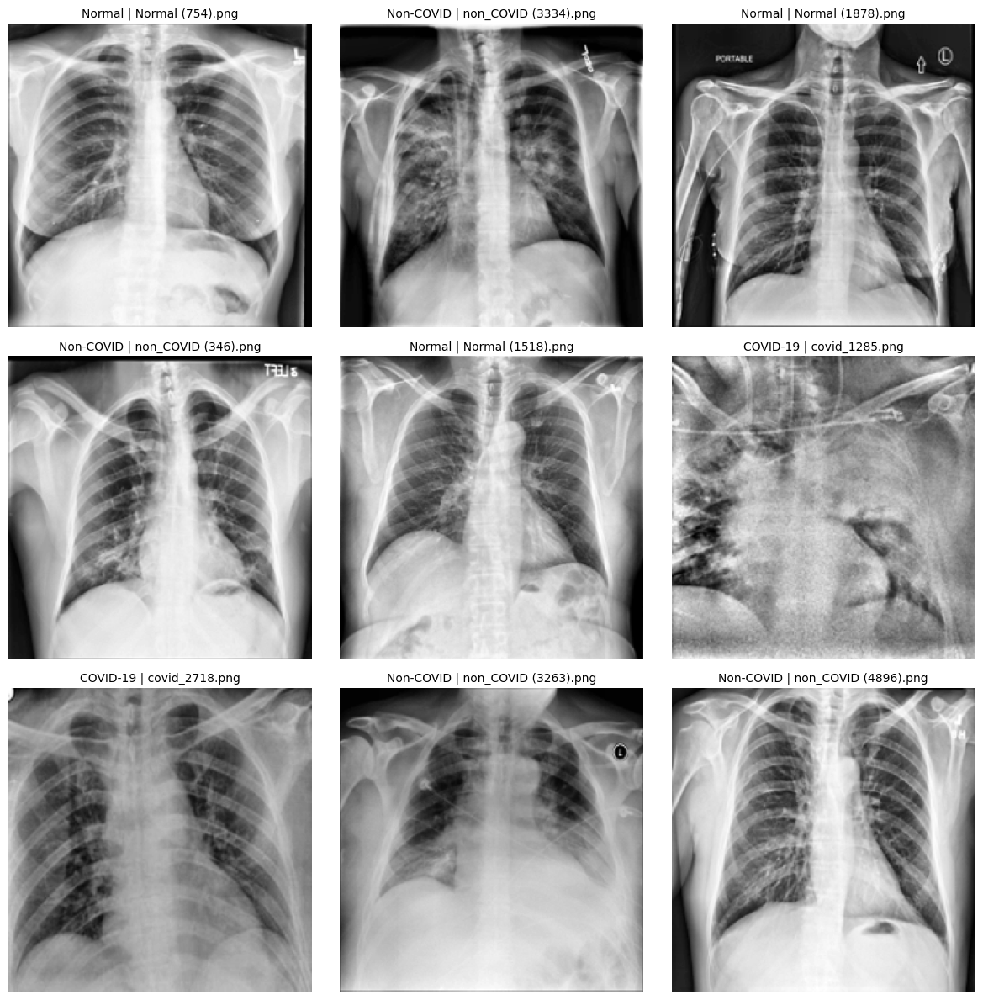

In [11]:
# %%
# Cell 5A - Sanity check & visualisasi sampel dari array tersimpan (robust)
import os, numpy as np, pandas as pd, matplotlib.pyplot as plt

# Pastikan konstanta & kelas ada
try:
    CLASSES
except NameError:
    CLASSES = {0: "COVID-19", 1: "Non-COVID", 2: "Normal"}

# Pastikan X, Y terdefinisi (kalau belum, muat dari file)
arr_path = ARTIFACTS / "processed_infection.npz"
if "X" not in globals() or "Y" not in globals():
    data = np.load(arr_path, allow_pickle=True)
    X = data["X"]; Y = data["Y"]
else:
    # Tetap muat 'data' untuk mengambil 'paths' (jika ada)
    data = np.load(arr_path, allow_pickle=True)

rng = np.random.RandomState(RANDOM_STATE)

# --- Ringkasan
print("Ringkasan array tersimpan:")
print("- X dtype/shape:", X.dtype, X.shape)
print("- Y dtype/shape:", Y.dtype, Y.shape)
class_counts = pd.Series(np.bincount(Y), index=[0,1,2]).rename(index=CLASSES)
display(class_counts.to_frame("count"))

# --- Ambil paths jika tersedia
paths_from_npz = data["paths"] if "paths" in data.files else None

# --- Visualisasi grid
k = min(9, len(Y))
idxs = rng.choice(len(Y), size=k, replace=False)

fig_rows = int(np.ceil(k/3))
fig, axs = plt.subplots(fig_rows, 3, figsize=(12, 4*fig_rows))
axs = np.atleast_1d(axs).flatten()

for ax, i in zip(axs, idxs):
    ax.imshow(X[i], cmap="gray")
    if paths_from_npz is not None:
        title_right = os.path.basename(str(paths_from_npz[i]))
    else:
        title_right = f"idx={i}"
    ax.set_title(f"{CLASSES[int(Y[i])]} | {title_right}", fontsize=10)
    ax.axis("off")

for ax in axs[k:]:
    ax.axis("off")

plt.tight_layout()
plt.show()


🔎 Contoh per split:


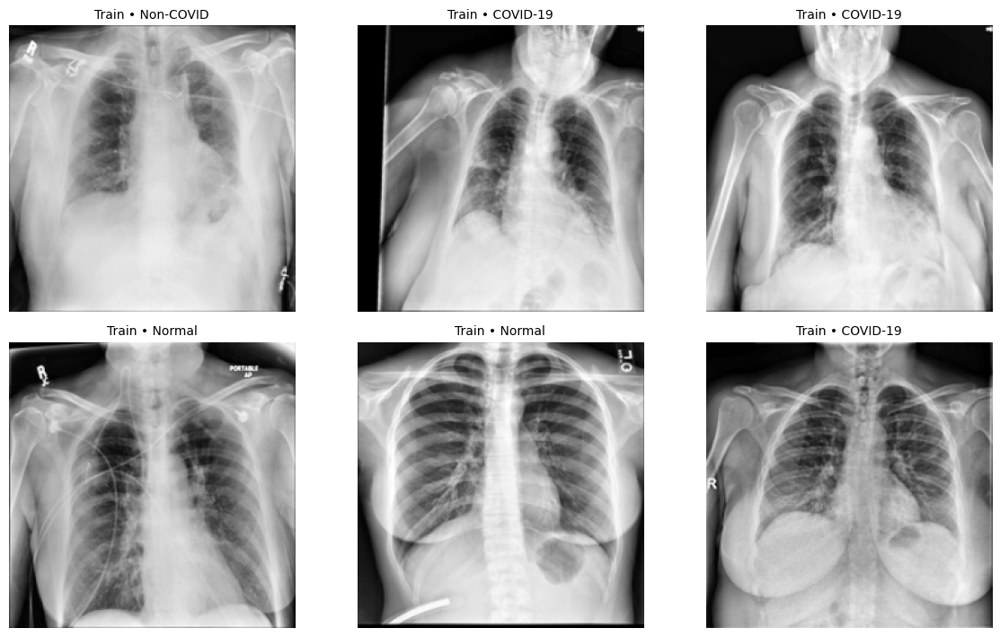

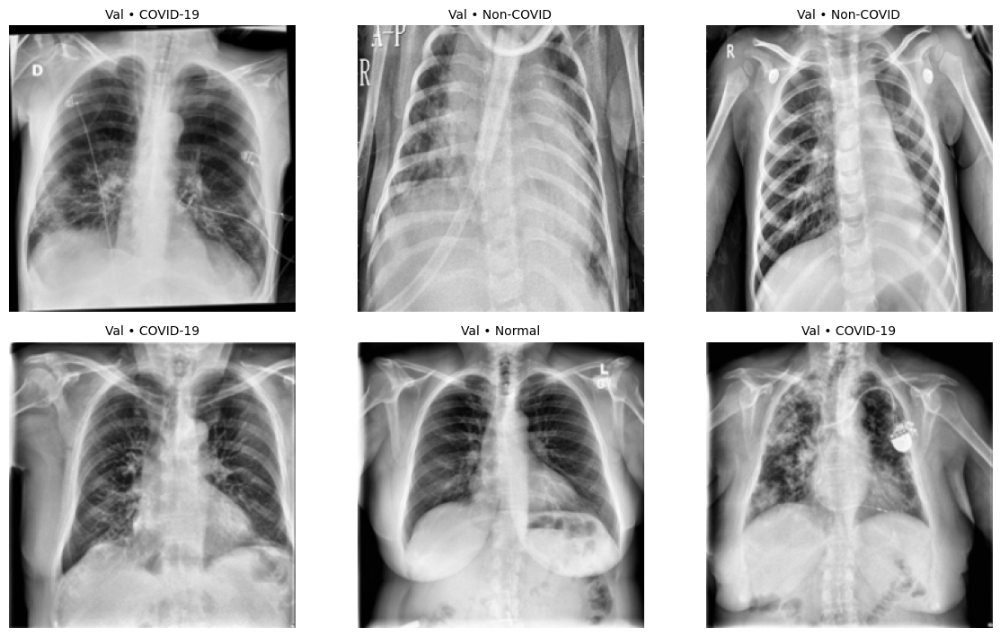

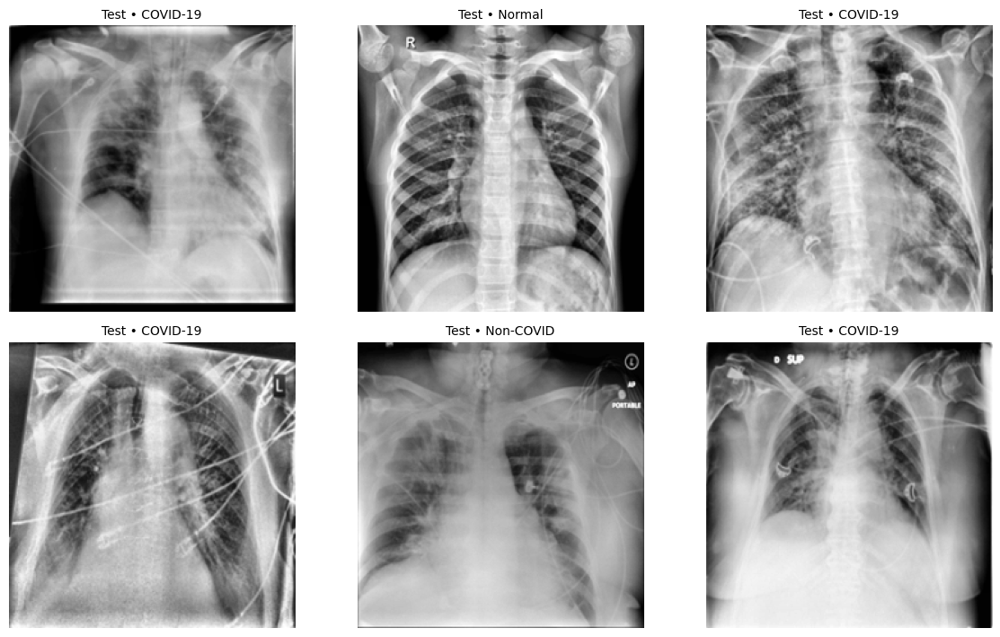

In [12]:
# %%
# Cell 6A - Visualisasi cepat per split
def show_split_examples(split_name, idxs, n=6):
    n = min(n, len(idxs))
    sel = rng.choice(idxs, size=n, replace=False)
    fig, axs = plt.subplots(int(np.ceil(n/3)), 3, figsize=(12, 3.6*int(np.ceil(n/3))))
    axs = axs.flatten()
    for ax, i in zip(axs, sel):
        ax.imshow(X[i], cmap="gray")
        ax.set_title(f"{split_name} • {CLASSES[int(Y[i])]}", fontsize=10)
        ax.axis("off")
    for ax in axs[n:]:
        ax.axis("off")
    plt.tight_layout()
    plt.show()

print("🔎 Contoh per split:")
show_split_examples("Train", train_idx, n=6)
show_split_examples("Val",   val_idx,   n=6)
show_split_examples("Test",  test_idx,  n=6)


In [13]:
# %%
# Cell 7 - Classic features (HOG) → Feature Selection → Feature Scaling → Classifiers

# === Guard & imports
import os, numpy as np, pandas as pd
from pathlib import Path
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import Pipeline
from sklearn.svm import SVC, LinearSVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report, confusion_matrix, f1_score
from sklearn.feature_selection import SelectKBest, f_classif
from skimage.feature import hog
from tqdm import tqdm
import joblib
import matplotlib.pyplot as plt

# Konstanta & path
try:
    ARTIFACTS
except NameError:
    ARTIFACTS = Path("./artifacts")

arr_path     = ARTIFACTS / "processed_infection.npz"
splits_path  = ARTIFACTS / "splits.npz"
hog_path     = ARTIFACTS / "hog_features.npz"
selector_pth = ARTIFACTS / "feature_selector.joblib"
scaler_pth   = ARTIFACTS / "feature_scaler.joblib"

# Muat X,Y jika belum ada
if "X" not in globals() or "Y" not in globals():
    data = np.load(arr_path, allow_pickle=True)
    X = data["X"]; Y = data["Y"]

# Muat split jika belum ada
if "train_idx" not in globals() or "val_idx" not in globals() or "test_idx" not in globals():
    s = np.load(splits_path, allow_pickle=True)
    train_idx, val_idx, test_idx = s["train_idx"], s["val_idx"], s["test_idx"]

# === HOG (Feature Extraction) ===
try:
    X_hog
except NameError:
    X_hog = None

if X_hog is None:
    if hog_path.exists():
        hf = np.load(hog_path)
        X_hog = hf["X_hog"]
        print("Loaded HOG features", X_hog.shape)
    else:
        X_hog_list = []
        for im in tqdm(X, desc="HOG"):
            im_uint = (im * 255).astype(np.uint8)
            feat = hog(
                im_uint,
                pixels_per_cell=(16, 16),
                cells_per_block=(2, 2),
                orientations=9,
                feature_vector=True,
            )
            X_hog_list.append(feat)
        X_hog = np.stack(X_hog_list)
        np.savez_compressed(hog_path, X_hog=X_hog)
        print("Saved HOG features", X_hog.shape)

assert X_hog.shape[0] == len(X), f"HOG rows ({X_hog.shape[0]}) != X ({len(X)})"

# === Feature Selection (SelectKBest) → pilih k dengan val split ===
# Catatan:
# - Selektor di-fit HANYA pakai train.
# - Kita pilih k dari kandidat agar memaksimalkan f1_macro di VAL dengan model cepat (LinearSVC).
# - Pastikan k <= jumlah fitur HOG.
n_feat = X_hog.shape[1]
k_candidates = [256, 512, 1024, 2048, 4096]
k_candidates = [k for k in k_candidates if k <= n_feat]
if not k_candidates:
    k_candidates = [min(256, n_feat)]

if selector_pth.exists() and scaler_pth.exists():
    selector = joblib.load(selector_pth)
    scaler   = joblib.load(scaler_pth)
    print("Loaded selector & scaler.")
else:
    print("Selecting k with validation…")
    best_k, best_f1 = None, -1.0
    # Pakai model ringan untuk pemilihan k
    base_clf = LinearSVC(class_weight="balanced", random_state=RANDOM_STATE)

    for k in k_candidates:
        sel = SelectKBest(score_func=f_classif, k=k)
        Xtr_sel = sel.fit_transform(X_hog[train_idx], Y[train_idx])
        Xva_sel = sel.transform(X_hog[val_idx])

        # Scaling setelah SELECTION (sesuai permintaan)
        sc = StandardScaler(with_mean=True, with_std=True)
        Xtr_sc = sc.fit_transform(Xtr_sel)
        Xva_sc = sc.transform(Xva_sel)

        base_clf.fit(Xtr_sc, Y[train_idx])
        yhat = base_clf.predict(Xva_sc)
        f1 = f1_score(Y[val_idx], yhat, average="macro")
        print(f"  k={k:>4}  val f1_macro={f1:.4f}")
        if f1 > best_f1:
            best_f1, best_k = f1, k

    print(f"→ Chosen k = {best_k} (val f1_macro={best_f1:.4f})")

    # Fit final selector & scaler di TRAIN
    selector = SelectKBest(score_func=f_classif, k=best_k)
    Xtr_sel = selector.fit_transform(X_hog[train_idx], Y[train_idx])

    scaler = StandardScaler(with_mean=True, with_std=True)
    scaler.fit(Xtr_sel)

    joblib.dump(selector, selector_pth)
    joblib.dump(scaler,   scaler_pth)
    print("Saved selector & scaler.")

# Transform seluruh split dengan urutan: HOG → SelectKBest → StandardScaler
def transform_feat(Xhog):
    X_sel = selector.transform(Xhog)
    X_sc  = scaler.transform(X_sel)
    return X_sc

Xtr = transform_feat(X_hog[train_idx])
Xva = transform_feat(X_hog[val_idx])
Xte = transform_feat(X_hog[test_idx])
print("Shapes → Xtr:", Xtr.shape, "| Xva:", Xva.shape, "| Xte:", Xte.shape)

# === Train & Eval helper ===
clf_dir = ARTIFACTS / "classic_models"
clf_dir.mkdir(exist_ok=True)

def train_and_eval(clf, name, Xtr, Xva, Xte):
    model_path = clf_dir / f"{name}.joblib"
    if model_path.exists():
        clf = joblib.load(model_path)
        print(f"Loaded {name}")
    else:
        clf.fit(Xtr, Y[train_idx])
        joblib.dump(clf, model_path)
        print("Saved", name)
    for stage, Xsplit, idx in [("Val", Xva, val_idx), ("Test", Xte, test_idx)]:
        ypred = clf.predict(Xsplit)
        print(f"=== {name} [{stage}] ===")
        print(classification_report(Y[idx], ypred, digits=4))
        print("Confusion matrix:\n", confusion_matrix(Y[idx], ypred))

# === Classifiers (tidak perlu scaler lagi; sudah di-scaling) ===
svm_rbf = SVC(C=10, kernel="rbf", gamma="scale",
              class_weight="balanced", probability=True, random_state=RANDOM_STATE)
train_and_eval(svm_rbf, "svm_rbf", Xtr, Xva, Xte)

rf = RandomForestClassifier(n_estimators=300, n_jobs=-1,
                            class_weight="balanced_subsample", random_state=RANDOM_STATE)
train_and_eval(rf, "random_forest", Xtr, Xva, Xte)

knn = KNeighborsClassifier(n_neighbors=5)
train_and_eval(knn, "knn", Xtr, Xva, Xte)

HOG: 100%|██████████| 5826/5826 [00:45<00:00, 127.99it/s]


Saved HOG features (5826, 6084)
Selecting k with validation…


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


  k= 256  val f1_macro=0.6843


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


  k= 512  val f1_macro=0.6944


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


  k=1024  val f1_macro=0.7317


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


  k=2048  val f1_macro=0.7462


/usr/local/lib/python3.11/dist-packages/sklearn/svm/_base.py:1244: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  warnings.warn(


  k=4096  val f1_macro=0.7669
→ Chosen k = 4096 (val f1_macro=0.7669)
Saved selector & scaler.
Shapes → Xtr: (4078, 4096) | Xva: (874, 4096) | Xte: (874, 4096)
Saved svm_rbf
=== svm_rbf [Val] ===
              precision    recall  f1-score   support

           0     0.8855    0.9382    0.9111       437
           1     0.7835    0.6941    0.7361       219
           2     0.8249    0.8211    0.8230       218

    accuracy                         0.8478       874
   macro avg     0.8313    0.8178    0.8234       874
weighted avg     0.8448    0.8478    0.8453       874

Confusion matrix:
 [[410  18   9]
 [ 38 152  29]
 [ 15  24 179]]
=== svm_rbf [Test] ===
              precision    recall  f1-score   support

           0     0.8688    0.9542    0.9095       437
           1     0.8626    0.7169    0.7830       219
           2     0.8491    0.8257    0.8372       218

    accuracy                         0.8627       874
   macro avg     0.8601    0.8323    0.8432       874
weighted 

,model,split,accuracy,precision_macro,recall_macro,f1_macro
5,knn,Test,0.775744,0.784148,0.722516,0.738887
3,random_forest,Test,0.760870,0.806633,0.696612,0.718847
1,svm_rbf,Test,0.862700,0.860148,0.832272,0.843246
4,knn,Val,0.776888,0.797125,0.719517,0.734549
2,random_forest,Val,0.755149,0.805014,0.682907,0.704366
0,svm_rbf,Val,0.847826,0.831306,0.817793,0.823392


🗒️  Disimpan: artifacts/viz_metrics/classic_models_metrics_20251104-032836.csv


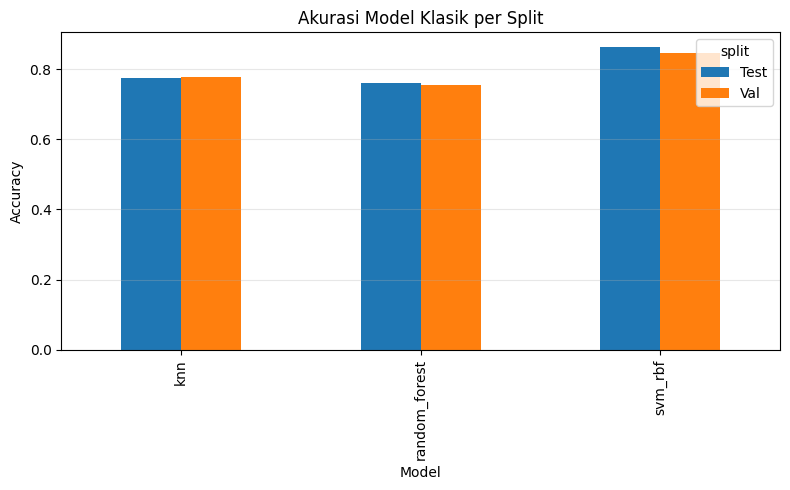

💾 Disimpan: artifacts/viz_metrics/classic_models_accuracy_bar_20251104-032836.png


In [14]:
# %%
# Cell 7A — Ringkasan metrik model klasik (Val/Test) + Bar chart akurasi + CSV
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from sklearn.metrics import accuracy_score, precision_recall_fscore_support
import joblib

# --- Paths & dirs
try:
    ARTIFACTS
except NameError:
    ARTIFACTS = Path("./artifacts")

VIZ_METRICS = ARTIFACTS / "viz_metrics"
VIZ_METRICS.mkdir(parents=True, exist_ok=True)

arr_path     = ARTIFACTS / "processed_infection.npz"      # berisi Y (dan X kalau mau dicek)
splits_path  = ARTIFACTS / "splits.npz"
hog_path     = ARTIFACTS / "hog_features.npz"             # HOG features (Cell 7)
selector_pth = ARTIFACTS / "feature_selector.joblib"      # SelectKBest (Cell 7)
scaler_pth   = ARTIFACTS / "feature_scaler.joblib"        # StandardScaler (Cell 7)
clf_dir      = ARTIFACTS / "classic_models"

# --- Load Y & splits
if "Y" not in globals():
    data_npz = np.load(arr_path, allow_pickle=True)
    Y = data_npz["Y"]

if not all(k in globals() for k in ["train_idx", "val_idx", "test_idx"]):
    s = np.load(splits_path, allow_pickle=True)
    train_idx, val_idx, test_idx = s["train_idx"], s["val_idx"], s["test_idx"]

# --- Load HOG features (harus sudah dibuat di Cell 7)
if not hog_path.exists():
    raise RuntimeError(f"HOG features belum ada. Jalankan Cell 7 dulu. Missing: {hog_path}")
hog_npz = np.load(hog_path)
X_hog = hog_npz["X_hog"]

# --- Load selector & scaler (fit di TRAIN pada Cell 7)
if not (selector_pth.exists() and scaler_pth.exists()):
    raise RuntimeError("Selector/Scaler belum ada. Jalankan Cell 7 dulu untuk membuatnya.")
selector = joblib.load(selector_pth)
scaler   = joblib.load(scaler_pth)

def transform_feat(Xhog):
    """HOG → SelectKBest → StandardScaler (urutan sesuai pipeline baru)."""
    X_sel = selector.transform(Xhog)
    X_sc  = scaler.transform(X_sel)
    return X_sc

# --- Transform VAL & TEST
Xva = transform_feat(X_hog[val_idx])
Xte = transform_feat(X_hog[test_idx])

# --- Load trained models
models_loaded = {}
for name in ["svm_rbf", "random_forest", "knn"]:
    path = clf_dir / f"{name}.joblib"
    if path.exists():
        models_loaded[name] = joblib.load(path)
    else:
        print(f"⚠️ Model {name} belum ada di {path}; jalankan training di Cell 7 terlebih dahulu.")

if not models_loaded:
    raise RuntimeError("Tidak ada model klasik yang dimuat. Latih dulu di Cell 7.")

# --- Hitung metrik per model & split
splits = {
    "Val":  (Xva, Y[val_idx]),
    "Test": (Xte, Y[test_idx]),
}

rows = []
for mname, m in models_loaded.items():
    for split_name, (Xsplit, ysplit) in splits.items():
        yhat = m.predict(Xsplit)
        acc = accuracy_score(ysplit, yhat)
        prec, rec, f1, _ = precision_recall_fscore_support(
            ysplit, yhat, average="macro", zero_division=0
        )
        rows.append({
            "model": mname,
            "split": split_name,
            "accuracy": acc,
            "precision_macro": prec,
            "recall_macro": rec,
            "f1_macro": f1,
        })

metrics_df = pd.DataFrame(rows).sort_values(["split", "model"])
display(metrics_df)

# --- Simpan CSV
from datetime import datetime
ts = datetime.now().strftime("%Y%m%d-%H%M%S")
csv_path = VIZ_METRICS / f"classic_models_metrics_{ts}.csv"
metrics_df.to_csv(csv_path, index=False)
print(f"🗒️  Disimpan: {csv_path}")

# --- Bar chart akurasi per model per split
pivot = metrics_df.pivot(index="model", columns="split", values="accuracy")
ax = pivot.plot(kind="bar", figsize=(8, 5))
ax.set_title("Akurasi Model Klasik per Split")
ax.set_ylabel("Accuracy")
ax.set_xlabel("Model")
ax.grid(axis="y", alpha=0.3)
plt.tight_layout()
bar_path = VIZ_METRICS / f"classic_models_accuracy_bar_{ts}.png"
plt.savefig(bar_path, dpi=150, bbox_inches="tight")
plt.show()
print(f"💾 Disimpan: {bar_path}")


🗒️  Saved per-sample predictions CSV: artifacts/viz_predictions/test_predictions_20251104-032901.csv


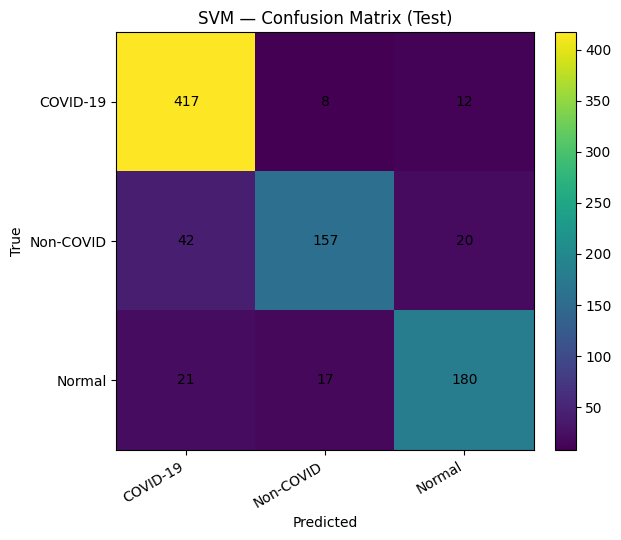

💾 Confusion matrix saved: artifacts/viz_predictions/svm_confusion_matrix_test_20251104-032901.png


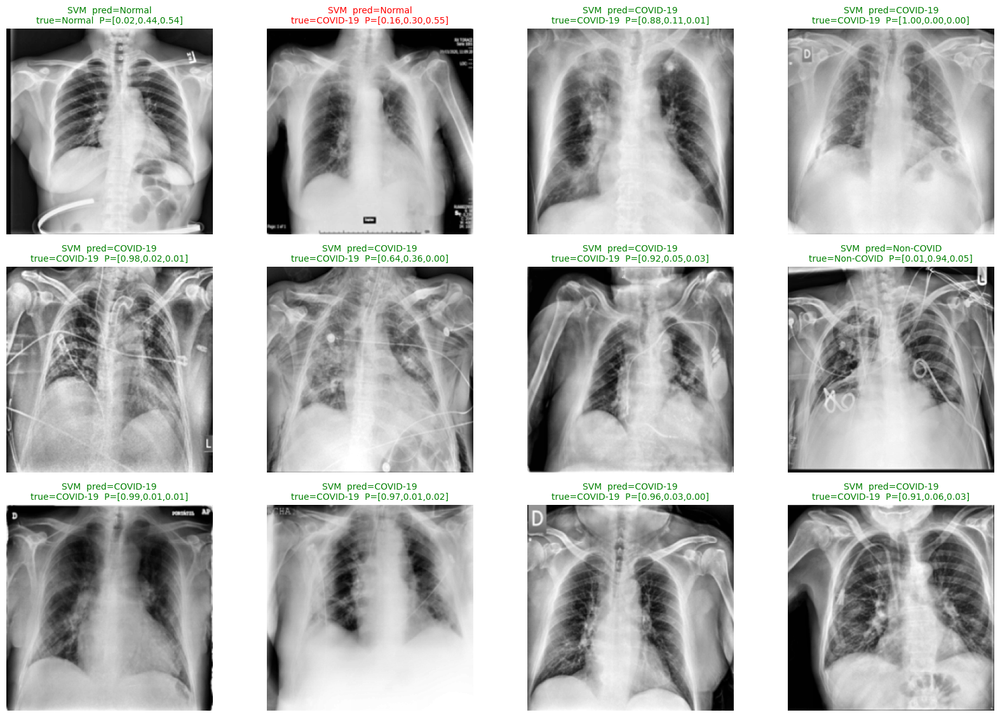

🖼️  Gallery saved: artifacts/viz_predictions/gallery_svm_random_12_20251104-032901.png


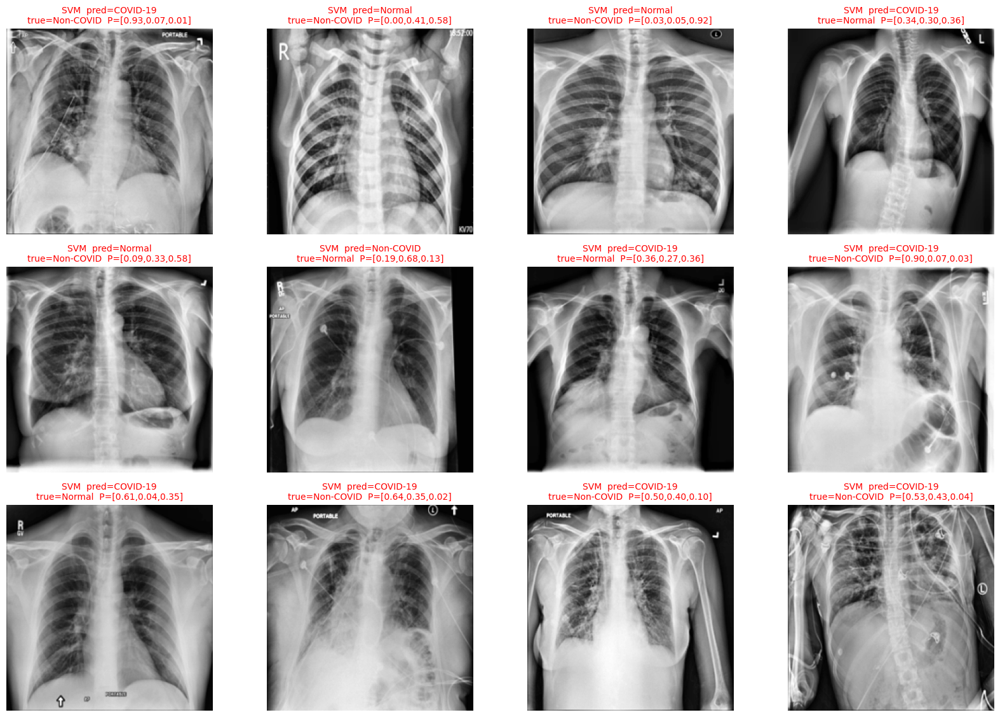

🖼️  Gallery saved: artifacts/viz_predictions/gallery_svm_errors_12_20251104-032901.png


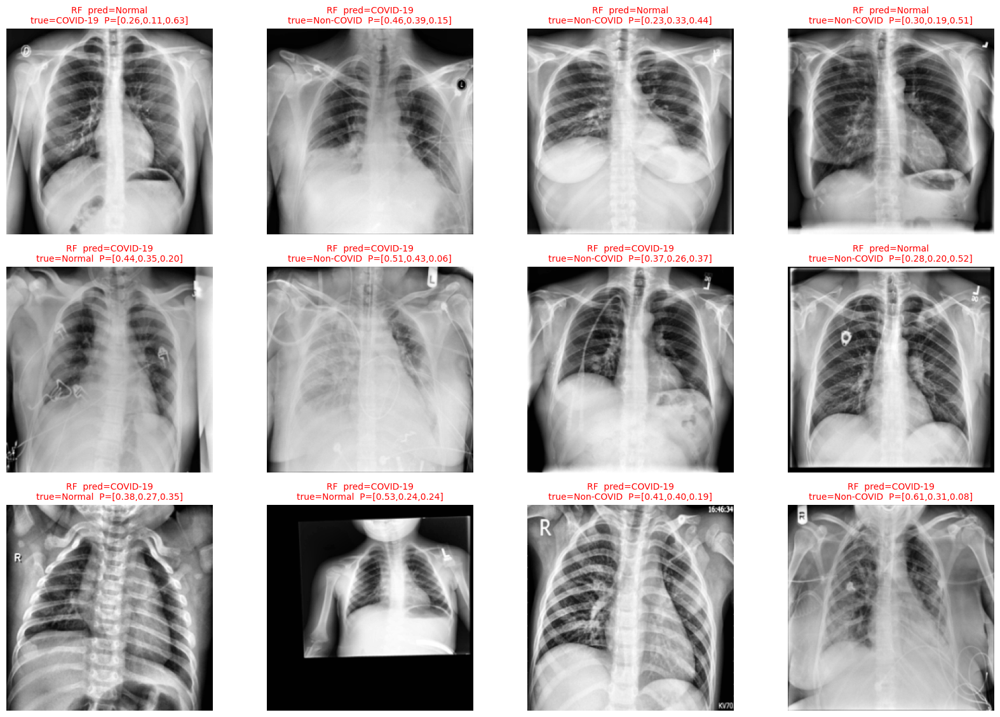

🖼️  Gallery saved: artifacts/viz_predictions/gallery_rf_errors_12_20251104-032901.png


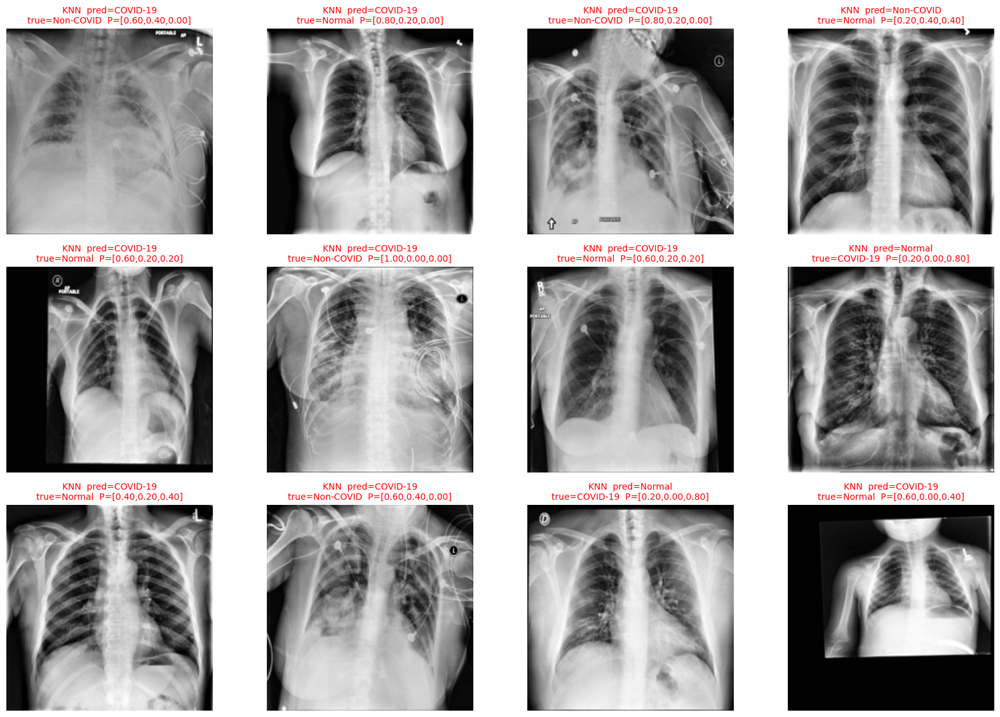

🖼️  Gallery saved: artifacts/viz_predictions/gallery_knn_errors_12_20251104-032901.png


In [15]:
# %%
# Cell 7B — Test-set predictions: per-sample table + visualisasi galeri (SVM/RF/KNN)
import os, numpy as np, pandas as pd, matplotlib.pyplot as plt
from datetime import datetime
from pathlib import Path
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score
import joblib

# ===== Guard: path & dirs =====
try:
    ARTIFACTS
except NameError:
    ARTIFACTS = Path("./artifacts")

VIZ_PRED = ARTIFACTS / "viz_predictions"
VIZ_PRED.mkdir(parents=True, exist_ok=True)

arr_path     = ARTIFACTS / "processed_infection.npz"      # X (H,W) float32 ~[0,1], Y, paths
splits_path  = ARTIFACTS / "splits.npz"
hog_path     = ARTIFACTS / "hog_features.npz"             # hasil Cell 7
selector_pth = ARTIFACTS / "feature_selector.joblib"      # hasil Cell 7
scaler_pth   = ARTIFACTS / "feature_scaler.joblib"        # hasil Cell 7
clf_dir      = ARTIFACTS / "classic_models"

# ===== CLASSES mapping =====
try:
    CLASSES
except NameError:
    CLASSES = {0: "COVID-19", 1: "Non-COVID", 2: "Normal"}

# ===== Data arrays & splits =====
if "X" not in globals() or "Y" not in globals():
    data_npz = np.load(arr_path, allow_pickle=True)
    X = data_npz["X"]; Y = data_npz["Y"]
else:
    data_npz = np.load(arr_path, allow_pickle=True)

if "test_idx" not in globals():
    s = np.load(splits_path, allow_pickle=True)
    train_idx, val_idx, test_idx = s["train_idx"], s["val_idx"], s["test_idx"]

# Paths (untuk laporan per-sampel)
paths_from_npz = data_npz["paths"] if "paths" in data_npz.files else np.array([f"idx_{i}" for i in range(len(X))])

# ===== Fitur klasik: HOG → SelectKBest → StandardScaler =====
if not hog_path.exists():
    raise RuntimeError(f"HOG features belum ada. Jalankan Cell 7 dulu. Missing: {hog_path}")
X_hog = np.load(hog_path)["X_hog"]

if not (selector_pth.exists() and scaler_pth.exists()):
    raise RuntimeError("Selector/Scaler belum ada. Jalankan Cell 7 dulu untuk membuatnya.")
selector = joblib.load(selector_pth)
scaler   = joblib.load(scaler_pth)

def transform_feat(Xhog):
    X_sel = selector.transform(Xhog)
    X_sc  = scaler.transform(X_sel)
    return X_sc

X_te_feat = transform_feat(X_hog[test_idx])
y_te      = Y[test_idx]
paths_te  = paths_from_npz[test_idx]

# ===== Muat model klasik =====
def _load_or_err(p):
    if not p.exists():
        raise RuntimeError(f"Model belum ada: {p}. Jalankan training di Cell 7.")
    return joblib.load(p)

svm = _load_or_err(clf_dir / "svm_rbf.joblib")
rf  = _load_or_err(clf_dir / "random_forest.joblib")
knn = _load_or_err(clf_dir / "knn.joblib")

# ===== Prediksi & probabilitas =====
def safe_proba(model, X):
    """Gunakan predict_proba jika ada; fallback softmax decision_function bila perlu."""
    if hasattr(model, "predict_proba"):
        return model.predict_proba(X)
    if hasattr(model, "decision_function"):
        z = model.decision_function(X)
        z = np.atleast_2d(z)
        z = z - z.max(axis=1, keepdims=True)
        expz = np.exp(z)
        prob = expz / expz.sum(axis=1, keepdims=True)
        if prob.shape[1] != 3:
            prob = np.tile(np.array([[1/3,1/3,1/3]]), (len(X),1))
        return prob
    return np.tile(np.array([[1/3,1/3,1/3]]), (len(X),1))

y_pred_svm = svm.predict(X_te_feat)
proba_svm  = safe_proba(svm, X_te_feat)

y_pred_rf  = rf.predict(X_te_feat)
proba_rf   = safe_proba(rf, X_te_feat)

y_pred_knn = knn.predict(X_te_feat)
proba_knn  = safe_proba(knn, X_te_feat)

# ===== Ringkas ke DataFrame per-sampel =====
def label_name(y): return np.vectorize(lambda k: CLASSES[int(k)])(y)

top_svm = proba_svm.max(axis=1)
top_rf  = proba_rf.max(axis=1)
top_knn = proba_knn.max(axis=1)

df_pred = pd.DataFrame({
    "path": paths_te,
    "true_id": y_te,
    "true": label_name(y_te),
    "svm_pred_id": y_pred_svm,
    "svm_pred": label_name(y_pred_svm),
    "svm_prob_max": top_svm,
    "rf_pred_id": y_pred_rf,
    "rf_pred": label_name(y_pred_rf),
    "rf_prob_max": top_rf,
    "knn_pred_id": y_pred_knn,
    "knn_pred": label_name(y_pred_knn),
    "knn_prob_max": top_knn,
})

ts = datetime.now().strftime("%Y%m%d-%H%M%S")
csv_path = VIZ_PRED / f"test_predictions_{ts}.csv"
df_pred.to_csv(csv_path, index=False)
print(f"🗒️  Saved per-sample predictions CSV: {csv_path}")

# ===== (Opsional) Confusion Matrix SVM =====
cm = confusion_matrix(y_te, y_pred_svm, labels=[0,1,2])
tick_labels = [CLASSES[i] for i in [0,1,2]]

plt.figure(figsize=(6.5, 5.5))
im = plt.imshow(cm, interpolation="nearest")
plt.title("SVM — Confusion Matrix (Test)")
plt.colorbar(im, fraction=0.046, pad=0.04)
plt.xticks(range(3), tick_labels, rotation=30, ha="right")
plt.yticks(range(3), tick_labels)
for i in range(cm.shape[0]):
    for j in range(cm.shape[1]):
        plt.text(j, i, str(cm[i, j]), ha="center", va="center", fontsize=10)
plt.xlabel("Predicted"); plt.ylabel("True")
plt.tight_layout()
cm_path = VIZ_PRED / f"svm_confusion_matrix_test_{ts}.png"
plt.savefig(cm_path, dpi=150, bbox_inches="tight")
plt.show()
print(f"💾 Confusion matrix saved: {cm_path}")

# ===== Galeri visualisasi sampel =====
def plot_gallery(model_name="svm", n=12, errors_only=False, seed=42):
    """
    Tampilkan grid contoh dari test set:
    - model_name: 'svm'|'rf'|'knn'
    - errors_only: True untuk hanya menampilkan yang salah
    """
    rng = np.random.RandomState(seed)
    if model_name == "svm":
        pred_ids, probas = y_pred_svm, proba_svm
    elif model_name == "rf":
        pred_ids, probas = y_pred_rf, proba_rf
    else:
        pred_ids, probas = y_pred_knn, proba_knn

    correct = pred_ids == y_te
    idx_pool = np.where(~correct)[0] if errors_only else np.arange(len(y_te))
    if len(idx_pool) == 0:
        print("Semua prediksi benar di test set untuk model", model_name)
        return

    n_show = min(n, len(idx_pool))
    chosen = rng.choice(idx_pool, size=n_show, replace=False)

    rows = int(np.ceil(n_show/4))
    cols = 4 if n_show >= 4 else n_show
    fig, axs = plt.subplots(rows, cols, figsize=(4.2*cols, 3.8*rows))
    axs = np.atleast_1d(axs).flatten()

    for ax, k in zip(axs, chosen):
        # tampilkan citra asli (hasil preprocessing CLAHE-normalized) untuk test sample k
        img = X[test_idx[k]]
        true_lbl = CLASSES[int(y_te[k])]
        pred_lbl = CLASSES[int(pred_ids[k])]
        pvec = probas[k]
        p_str = f"P=[{pvec[0]:.2f},{pvec[1]:.2f},{pvec[2]:.2f}]"

        ax.imshow(img, cmap="gray")
        ok = (pred_ids[k] == y_te[k])
        color = "green" if ok else "red"
        ax.set_title(f"{model_name.upper()}  pred={pred_lbl}\ntrue={true_lbl}  {p_str}", color=color, fontsize=10)
        ax.axis("off")

    for ax in axs[n_show:]:
        ax.axis("off")

    plt.tight_layout()
    fig_path = VIZ_PRED / f"gallery_{model_name}_{'errors' if errors_only else 'random'}_{n_show}_{ts}.png"
    plt.savefig(fig_path, dpi=150, bbox_inches="tight")
    plt.show()
    print(f"🖼️  Gallery saved: {fig_path}")

# ===== Tampilkan beberapa galeri =====
plot_gallery("svm", n=12, errors_only=False, seed=7)   # sampel acak SVM
plot_gallery("svm", n=12, errors_only=True,  seed=7)   # hanya yang salah SVM
plot_gallery("rf",  n=12, errors_only=True,  seed=7)   # hanya yang salah RF
plot_gallery("knn", n=12, errors_only=True,  seed=7)   # hanya yang salah KNN


> di cell ini saya menyadari sepertinya ada kesalahan, seharusnya jangan menerapkan masks pada datasets, ketika saya tes dengan gambar covid19 raw yang tidak dicrop, model salah memprediksi, malah mengira itu non-covid bahkan normal

In [16]:
# %%
# Cell 12 — Single Image Inference (AUTO on upload) → Prediksi CNN + SVM/RF/KNN
import os, io, numpy as np, pandas as pd, matplotlib.pyplot as plt
from datetime import datetime
from pathlib import Path
import joblib, cv2, tensorflow as tf
from IPython.display import display, clear_output
try:
    import ipywidgets as widgets
except Exception:
    widgets = None  # fallback jika ipywidgets tidak tersedia

# ==== Guard: konstanta & util dasar ====
try: ARTIFACTS
except NameError: ARTIFACTS = Path("./artifacts")
try: TARGET_SIZE
except NameError: TARGET_SIZE = (224, 224)
try: CLASSES
except NameError: CLASSES = {0: "COVID-19", 1: "Non-COVID", 2: "Normal"}

# ==== Preprocessing helpers (sinkron dengan Cell 4: CLAHE + Normalization) ====
# Jika fungsi dari Cell 4 sudah ada, pakai itu; jika belum, sediakan fallback identik di sini.
def _ensure_preproc_funcs():
    need_fallback = False
    for fn in ["load_image_raw_gray", "apply_clahe", "normalize_image", "preprocess_image"]:
        if fn not in globals():
            need_fallback = True
            break
    if not need_fallback:
        return

    # Fallback definisi yang sama dengan Cell 4
    def load_image_raw_gray(path, size=TARGET_SIZE):
        img = cv2.imread(str(path), cv2.IMREAD_GRAYSCALE)
        if img is None: raise FileNotFoundError(path)
        img = cv2.resize(img, size, interpolation=cv2.INTER_AREA)
        return img  # uint8 0..255

    def apply_clahe(img_uint8, clipLimit=2.0, tileGridSize=(8,8)):
        clahe = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
        return clahe.apply(img_uint8)

    def normalize_image(img, zscore=False, eps=1e-7):
        img = img.astype(np.float32)
        if zscore:
            m, s = img.mean(), img.std() + eps
            img = (img - m) / s
            img = np.clip(img, -5, 5)
            img_min, img_max = img.min(), img.max()
            return (img - img_min) / (img_max - img_min + eps)
        return img / 255.0

    def preprocess_image(path_or_arr,
                         size=TARGET_SIZE,
                         use_clahe=True,
                         clipLimit=2.0,
                         tileGridSize=(8,8),
                         normalize=True,
                         zscore=False):
        # path (str/Path) atau array uint8 grayscale
        if isinstance(path_or_arr, (str, Path)):
            raw = load_image_raw_gray(path_or_arr, size=size)
        else:
            raw = path_or_arr
            if raw.ndim == 3:
                raw = cv2.cvtColor(raw, cv2.COLOR_BGR2GRAY)
            raw = cv2.resize(raw, size, interpolation=cv2.INTER_AREA)
            raw = raw.astype(np.uint8)
        proc = apply_clahe(raw, clipLimit, tileGridSize) if use_clahe else raw
        if normalize:
            proc = normalize_image(proc, zscore=zscore)
        return proc.astype(np.float32)

    globals().update(locals())

_ensure_preproc_funcs()

def load_image_gray_from_bytes(bts, size=TARGET_SIZE):
    arr = np.frombuffer(bts, np.uint8)
    img = cv2.imdecode(arr, cv2.IMREAD_GRAYSCALE)
    if img is None: raise ValueError("Gagal decode gambar dari bytes.")
    img = cv2.resize(img, size, interpolation=cv2.INTER_AREA)
    # Terapkan CLAHE + normalisasi agar konsisten dengan training
    img_u8 = img.astype(np.uint8)
    img_eq = apply_clahe(img_u8, clipLimit=2.0, tileGridSize=(8,8))
    img_f  = img_eq.astype(np.float32) / 255.0
    return img_f

def load_image_gray(path, size=TARGET_SIZE):
    img = cv2.imread(str(path), cv2.IMREAD_GRAYSCALE)
    if img is None: raise FileNotFoundError(path)
    img = cv2.resize(img, size, interpolation=cv2.INTER_AREA)
    img_u8 = img.astype(np.uint8)
    img_eq = apply_clahe(img_u8, clipLimit=2.0, tileGridSize=(8,8))
    img_f  = img_eq.astype(np.float32) / 255.0
    return img_f

def preprocess_for_tf(img):
    # CNN kamu kemungkinan dilatih grayscale 1-channel; jika butuh 3-channel, duplikasi
    return np.stack([img, img, img], axis=-1).astype(np.float32)

# ==== Load artefak ====
# Classic pipeline artefak (Cell 7)
selector_pth = ARTIFACTS / "feature_selector.joblib"   # SelectKBest
scaler_pth   = ARTIFACTS / "feature_scaler.joblib"     # StandardScaler
clf_dir      = ARTIFACTS / "classic_models"

svm = joblib.load(clf_dir / "svm_rbf.joblib") if (clf_dir / "svm_rbf.joblib").exists() else None
rf  = joblib.load(clf_dir / "random_forest.joblib") if (clf_dir / "random_forest.joblib").exists() else None
knn = joblib.load(clf_dir / "knn.joblib") if (clf_dir / "knn.joblib").exists() else None

selector = joblib.load(selector_pth) if selector_pth.exists() else None
scaler   = joblib.load(scaler_pth)   if scaler_pth.exists()   else None

# CNN (opsional)
cnn_path = ARTIFACTS / "cnn_best.h5"
cnn_model = tf.keras.models.load_model(str(cnn_path)) if cnn_path.exists() else None

# HOG config (sama seperti training di Cell 7)
from skimage.feature import hog as sk_hog
HOG_CFG = dict(pixels_per_cell=(16,16), cells_per_block=(2,2), orientations=9, feature_vector=True)

# ==== Prediksi single image ====
def predict_single(img_gray_01):
    """
    img_gray_01 : ndarray [H,W] float32 in 0..1 (sudah CLAHE+normalize & resize TARGET_SIZE).
    """
    results = {}

    # --- CNN ---
    if cnn_model is not None:
        x3 = preprocess_for_tf(img_gray_01)[None, ...]
        probs = cnn_model.predict(x3, verbose=0)[0]
        pid = int(np.argmax(probs))
        results["cnn"] = {"pred_id": pid, "pred": CLASSES[pid], "probs": probs}

    # --- Classic (HOG → SelectKBest → StandardScaler → clf) ---
    if selector is not None and scaler is not None and (svm or rf or knn):
        im_uint = (img_gray_01 * 255).astype(np.uint8)
        feat = sk_hog(im_uint, **HOG_CFG).reshape(1, -1)
        # transform sesuai pipeline baru
        X_sel = selector.transform(feat)
        X_sc  = scaler.transform(X_sel)

        def proba_or_none(clf, X):
            if clf is None: return None
            if hasattr(clf, "predict_proba"): return clf.predict_proba(X)[0]
            if hasattr(clf, "decision_function"):
                z = clf.decision_function(X)
                z = z - z.max(axis=1, keepdims=True)
                p = np.exp(z) / np.exp(z).sum(axis=1, keepdims=True)
                return p[0] if p.shape[1] == 3 else np.array([1/3,1/3,1/3])
            return None

        if svm is not None:
            p = proba_or_none(svm, X_sc); y = int(svm.predict(X_sc)[0])
            results["svm"] = {"pred_id": y, "pred": CLASSES[y], "probs": p}
        if rf is not None:
            p = proba_or_none(rf, X_sc); y = int(rf.predict(X_sc)[0])
            results["rf"]  = {"pred_id": y, "pred": CLASSES[y], "probs": p}
        if knn is not None:
            p = proba_or_none(knn, X_sc); y = int(knn.predict(X_sc)[0])
            results["knn"] = {"pred_id": y, "pred": CLASSES[y], "probs": p}

    return results

def results_to_dataframe(results):
    rows = []
    for name, info in results.items():
        probs = info.get("probs", None)
        row = {"model": name.upper(), "pred_id": info["pred_id"], "pred": info["pred"]}
        if probs is not None and len(probs) == 3:
            row.update({
                "P(COVID-19)": float(probs[0]),
                "P(Non-COVID)": float(probs[1]),
                "P(Normal)": float(probs[2]),
            })
        rows.append(row)
    return pd.DataFrame(rows).set_index("model")

def show_prob_bar(df_preds):
    cols = ["P(COVID-19)", "P(Non-COVID)", "P(Normal)"]
    sub = df_preds[[c for c in cols if c in df_preds.columns]]
    if sub.empty: return
    ax = sub.plot(kind="bar", figsize=(7,4))
    ax.set_ylim(0,1)
    ax.set_title("Probabilitas per Model")
    ax.grid(axis="y", alpha=0.3)
    plt.tight_layout(); plt.show()

def visualize_single(img_gray_01, df_preds, title=""):
    plt.figure(figsize=(5,5))
    plt.imshow(img_gray_01, cmap="gray"); plt.axis("off")
    plt.title(title or "Input (CLAHE + Normalized)")
    plt.show()
    display(df_preds)
    show_prob_bar(df_preds)

# ==== OUTPUT area untuk menampung hasil ====
out = widgets.Output() if widgets is not None else None

def process_bytes_and_render(bts, source_name="uploaded"):
    # Konsisten dengan training: resize → CLAHE → normalize
    img = load_image_gray_from_bytes(bts, size=TARGET_SIZE)
    results = predict_single(img)
    df_preds = results_to_dataframe(results)
    ts = datetime.now().strftime("%Y%m%d-%H%M%S")
    out_dir = ARTIFACTS / "single_inference"; out_dir.mkdir(parents=True, exist_ok=True)
    csv_path = out_dir / f"single_inference_{ts}.csv"
    df_preds.to_csv(csv_path)
    if out is not None:
        with out:
            clear_output(wait=True)
            visualize_single(img, df_preds, title=f"{source_name}")
            print(f"🗒️ Saved predictions CSV: {csv_path}")
    else:
        visualize_single(img, df_preds, title=f"{source_name}")
        print(f"🗒️ Saved predictions CSV: {csv_path}")

# ==== WIDGET upload (AUTO proses) — kompatibel ipywidgets v7 & v8 ====
if widgets is not None:
    uploader = widgets.FileUpload(accept=".png,.jpg,.jpeg", multiple=False)
    btn_process = widgets.Button(description="Process latest upload", button_style="")
    lbl = widgets.HTML("<b>Upload gambar (.png/.jpg) — diproses otomatis saat selesai upload:</b>")
    out = widgets.Output()
    box = widgets.VBox([lbl, widgets.HBox([uploader, btn_process]), out])
    display(box)

    def _extract_first_file(upl):
        v = upl.value
        if not v:
            return None
        # ipywidgets v8: tuple of UploadedFile
        if isinstance(v, tuple):
            up = v[0]
            if isinstance(up, dict):
                name = up.get("name", "uploaded_image")
                content = up.get("content", up.get("data"))
            else:
                name = getattr(up, "name", "uploaded_image")
                content = getattr(up, "content", getattr(up, "data", None))
            return (name, content)
        # ipywidgets v7: dict keyed by filename
        if isinstance(v, dict):
            k = list(v.keys())[0]
            meta = v[k].get("metadata", {})
            name = meta.get("name", k)
            content = v[k].get("content", v[k].get("data"))
            return (name, content)
        return None

    def _reset_uploader(upl):
        try:
            upl.value = ()          # v8
        except Exception:
            try:
                upl.value.clear()   # v7
                upl._counter = 0
            except Exception:
                pass

    def _process_upload_from_widget():
        info = _extract_first_file(uploader)
        if not info:
            with out:
                print("No file payload detected yet.")
            return
        name, content = info
        if content is None:
            with out:
                print("Upload payload has no content.")
            return
        try:
            with out:
                clear_output(wait=True)
                process_bytes_and_render(bytes(content), source_name=f"Uploaded: {name}")
        except Exception as e:
            with out:
                clear_output(wait=True)
                print("❌ Error while processing upload:", repr(e))
        finally:
            _reset_uploader(uploader)

    def _on_upload_change(change):
        if change["name"] == "value":
            _process_upload_from_widget()

    uploader.observe(_on_upload_change, names="value")
    btn_process.on_click(lambda _: _process_upload_from_widget())

else:
    print("ipywidgets tidak tersedia. Gunakan mode path manual (run_inference_from_path).")

# ==== MODE PATH MANUAL (alternatif jika tanpa widget) ====
IMAGE_PATH = ""  # isi path file jika ipywidgets tidak tersedia, contoh: "/kaggle/input/foo/bar.png"

def run_inference_from_path(path):
    if not path or not os.path.exists(path):
        raise RuntimeError("IMAGE_PATH kosong / tidak valid.")
    img = load_image_gray(path, size=TARGET_SIZE)
    results = predict_single(img)
    df_preds = results_to_dataframe(results)
    visualize_single(img, df_preds, title=f"Path: {os.path.basename(path)}")
    ts = datetime.now().strftime("%Y%m%d-%H%M%S")
    out_dir = ARTIFACTS / "single_inference"; out_dir.mkdir(parents=True, exist_ok=True)
    csv_path = out_dir / f"single_inference_{ts}.csv"
    df_preds.to_csv(csv_path)
    print(f"🗒️ Saved predictions CSV: {csv_path}")

# Jika tanpa widget: set IMAGE_PATH lalu panggil:
# run_inference_from_path(IMAGE_PATH)


Tahap 4 — Analisis Kesalahan & Interpretasi Model

Helper & Loader (jamin robust; skip jika sudah ada)

In [17]:
# Cell 8 — Helper & Loader
import os, json, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
from pathlib import Path
from datetime import datetime
from sklearn.metrics import confusion_matrix, classification_report, precision_recall_fscore_support, accuracy_score
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.svm import SVC
from sklearn.tree import plot_tree

try:
    ARTIFACTS
except NameError:
    ARTIFACTS = Path("./artifacts")
ARTIFACTS.mkdir(exist_ok=True, parents=True)

VIZ_STAGE4 = ARTIFACTS / "viz_stage4"
VIZ_STAGE4.mkdir(parents=True, exist_ok=True)

# Konstanta kelas
try:
    CLASSES
except NameError:
    CLASSES = {0: "COVID-19", 1: "Non-COVID", 2: "Normal"}

# Muat arrays & splits bila belum ada di memori
arr_path    = ARTIFACTS / "processed_infection.npz"
splits_path = ARTIFACTS / "splits.npz"
hog_path    = ARTIFACTS / "hog_features.npz"

if "X" not in globals() or "Y" not in globals():
    data_npz = np.load(arr_path, allow_pickle=True)
    X = data_npz["X"]; Y = data_npz["Y"]
    paths_all = data_npz["paths"] if "paths" in data_npz.files else np.array([f"idx_{i}" for i in range(len(X))])
else:
    data_npz = np.load(arr_path, allow_pickle=True)
    paths_all = data_npz["paths"] if "paths" in data_npz.files else np.array([f"idx_{i}" for i in range(len(X))])

if not all(k in globals() for k in ["train_idx","val_idx","test_idx"]):
    s = np.load(splits_path, allow_pickle=True)
    train_idx, val_idx, test_idx = s["train_idx"], s["val_idx"], s["test_idx"]

# HOG features + selector/scaler
X_hog = np.load(hog_path)["X_hog"]
selector = joblib.load(ARTIFACTS / "feature_selector.joblib")
scaler   = joblib.load(ARTIFACTS / "feature_scaler.joblib")

def transform_feat(Xhog):
    X_sel = selector.transform(Xhog)
    return scaler.transform(X_sel)

# Fit-splits (sudah sama dengan training model klasik)
Xtr = transform_feat(X_hog[train_idx])
Xva = transform_feat(X_hog[val_idx])
Xte = transform_feat(X_hog[test_idx])
y_tr, y_va, y_te = Y[train_idx], Y[val_idx], Y[test_idx]
paths_te = paths_all[test_idx]

# Muat model
clf_dir = ARTIFACTS / "classic_models"
svm = joblib.load(clf_dir / "svm_rbf.joblib")
rf  = joblib.load(clf_dir / "random_forest.joblib")
knn = joblib.load(clf_dir / "knn.joblib")

def safe_proba(model, X):
    if hasattr(model, "predict_proba"):
        return model.predict_proba(X)
    if hasattr(model, "decision_function"):
        z = model.decision_function(X)
        z = np.atleast_2d(z)
        z = z - z.max(axis=1, keepdims=True)
        expz = np.exp(z)
        return expz / expz.sum(axis=1, keepdims=True)
    # fallback uniform
    K = len(np.unique(Y))
    return np.ones((len(X), K))/K

ts = datetime.now().strftime("%Y%m%d-%H%M%S")


Langkah 1: Statistik Dasar (Confusion Matrix + Classification Report semua model)

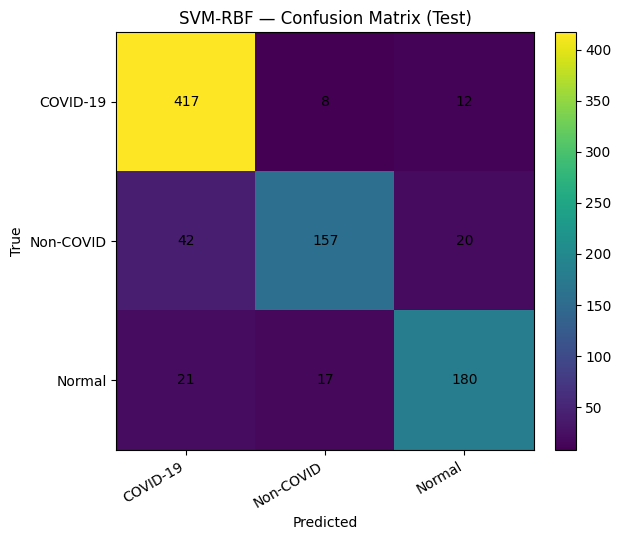

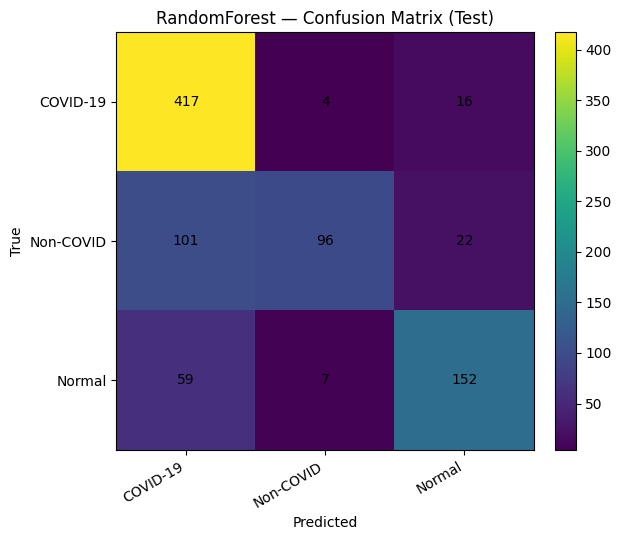

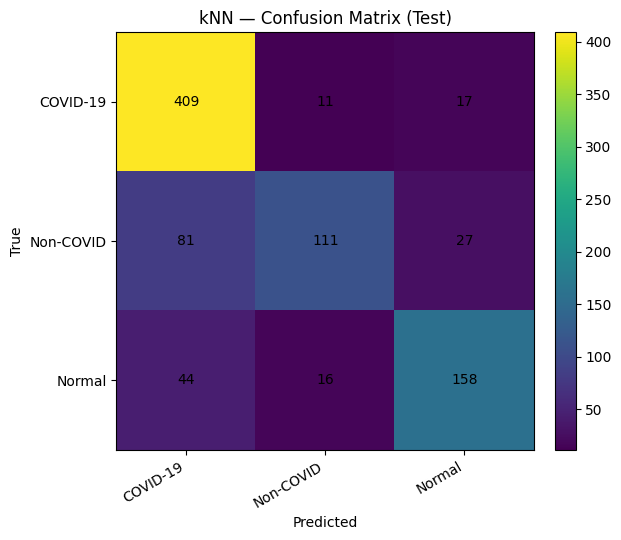

,model,accuracy,precision_macro,recall_macro,f1_macro
0,SVM-RBF,0.862700,0.860148,0.832272,0.843246
2,kNN,0.775744,0.784148,0.722516,0.738887
1,RandomForest,0.760870,0.806633,0.696612,0.718847


🗒️  Saved: artifacts/viz_stage4/stage4_basic_stats_20251104-032919.csv


In [18]:
# Cell 9 — Confusion Matrix & Classification Report untuk semua model (Test)
def plot_cm(cm, title, savepath=None):
    plt.figure(figsize=(6.5,5.5))
    im = plt.imshow(cm, interpolation="nearest")
    plt.title(title); plt.colorbar(im, fraction=0.046, pad=0.04)
    tick_labels = [CLASSES[i] for i in [0,1,2]]
    plt.xticks(range(3), tick_labels, rotation=30, ha="right")
    plt.yticks(range(3), tick_labels)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(j, i, str(cm[i, j]), ha="center", va="center", fontsize=10)
    plt.xlabel("Predicted"); plt.ylabel("True")
    plt.tight_layout()
    if savepath: plt.savefig(savepath, dpi=150, bbox_inches="tight")
    plt.show()

stats_rows = []
for name, clf in [("SVM-RBF", svm), ("RandomForest", rf), ("kNN", knn)]:
    yhat = clf.predict(Xte)
    cm   = confusion_matrix(y_te, yhat, labels=[0,1,2])
    report = classification_report(y_te, yhat, output_dict=True, zero_division=0)
    acc = accuracy_score(y_te, yhat)
    prec, rec, f1, _ = precision_recall_fscore_support(y_te, yhat, average="macro", zero_division=0)
    stats_rows.append({"model":name, "accuracy":acc, "precision_macro":prec, "recall_macro":rec, "f1_macro":f1})

    plot_cm(cm, f"{name} — Confusion Matrix (Test)", VIZ_STAGE4 / f"cm_{name.replace('-','').lower()}_{ts}.png")
    # simpan classification report json (untuk lampiran)
    with open(VIZ_STAGE4 / f"classification_report_{name.replace('-','').lower()}_{ts}.json", "w") as f:
        json.dump(report, f, indent=2)

df_stats = pd.DataFrame(stats_rows).sort_values("f1_macro", ascending=False)
display(df_stats)
df_stats.to_csv(VIZ_STAGE4 / f"stage4_basic_stats_{ts}.csv", index=False)
print("🗒️  Saved:", VIZ_STAGE4 / f"stage4_basic_stats_{ts}.csv")


Langkah 2A (SVM): PCA 2D + Decision Boundary (ilustratif) & Confidence Histogram

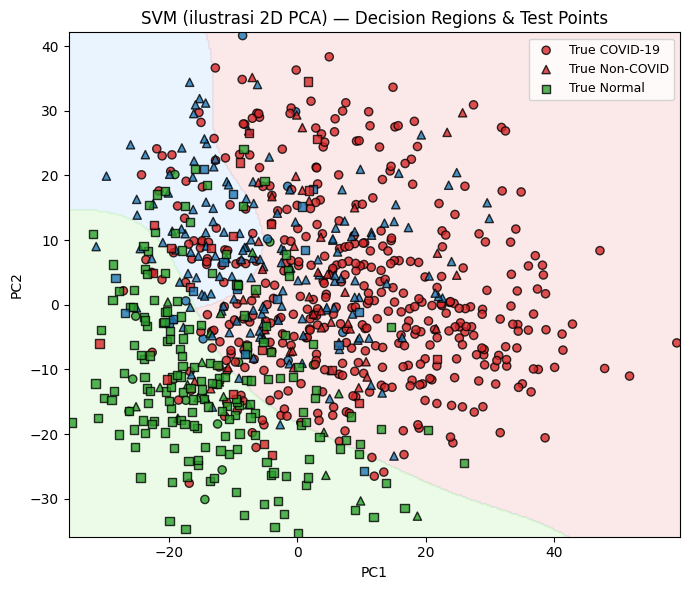

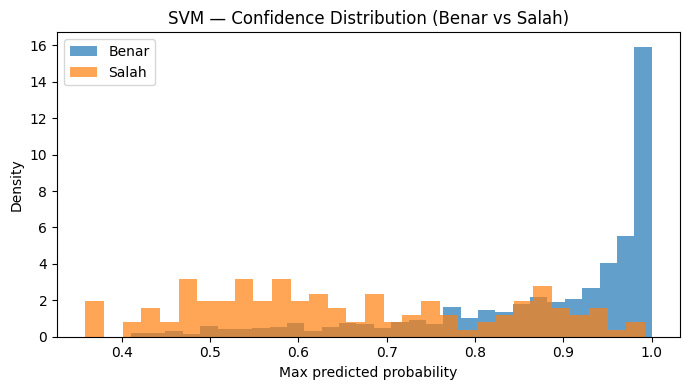

In [19]:
# Cell 10 — SVM: PCA 2D + Decision Boundary (visual) & Confidence Histogram
from matplotlib.colors import ListedColormap

# 1) PCA ke 2D pada fitur TEST (bisa juga gabung Train+Test jika ingin populasi lebih besar)
pca = PCA(n_components=2, random_state=42)
Z_te_2d = pca.fit_transform(Xte)

# 2) Latih SVM 2D untuk boundary (ilustrasi)
svm_2d = SVC(kernel="rbf", C=10, gamma="scale", probability=True, random_state=42)
svm_2d.fit(Z_te_2d, y_te)

# 3) Grid untuk boundary
x_min, x_max = Z_te_2d[:,0].min()-0.5, Z_te_2d[:,0].max()+0.5
y_min, y_max = Z_te_2d[:,1].min()-0.5, Z_te_2d[:,1].max()+0.5
xx, yy = np.meshgrid(np.linspace(x_min, x_max, 300), np.linspace(y_min, y_max, 300))
ZZ = svm_2d.predict(np.c_[xx.ravel(), yy.ravel()]).reshape(xx.shape)

cmap_bg = ListedColormap(["#f7cac9","#cce5ff","#d1f7c4"])  # lembut, non-intrusif
plt.figure(figsize=(7,6))
plt.contourf(xx, yy, ZZ, alpha=0.4, cmap=cmap_bg)
# titik: warna=prediksi SVM asli (bukan 2D), shape=label true
yhat_svm = svm.predict(Xte)
for cls, marker in zip([0,1,2], ["o","^","s"]):
    idx = (y_te==cls)
    plt.scatter(Z_te_2d[idx,0], Z_te_2d[idx,1],
                c=yhat_svm[idx], cmap=ListedColormap(["#d62728","#1f77b4","#2ca02c"]),
                marker=marker, edgecolor="k", s=35, alpha=0.8, label=f"True {CLASSES[cls]}")
plt.title("SVM (ilustrasi 2D PCA) — Decision Regions & Test Points")
plt.xlabel("PC1"); plt.ylabel("PC2"); plt.legend(loc="best", fontsize=9)
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"svm_pca2d_boundary_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()

# Confidence histogram: max-prob TP vs FP/FN
proba_svm = safe_proba(svm, Xte)
maxp = proba_svm.max(axis=1)
correct = (yhat_svm == y_te)
plt.figure(figsize=(7,4))
plt.hist(maxp[correct], bins=30, alpha=0.7, label="Benar", density=True)
plt.hist(maxp[~correct], bins=30, alpha=0.7, label="Salah", density=True)
plt.xlabel("Max predicted probability"); plt.ylabel("Density")
plt.title("SVM — Confidence Distribution (Benar vs Salah)")
plt.legend()
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"svm_confidence_hist_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()


Langkah 2B (Random Forest): Feature Importance (Top-N) & Visualisasi Tree Dangkal

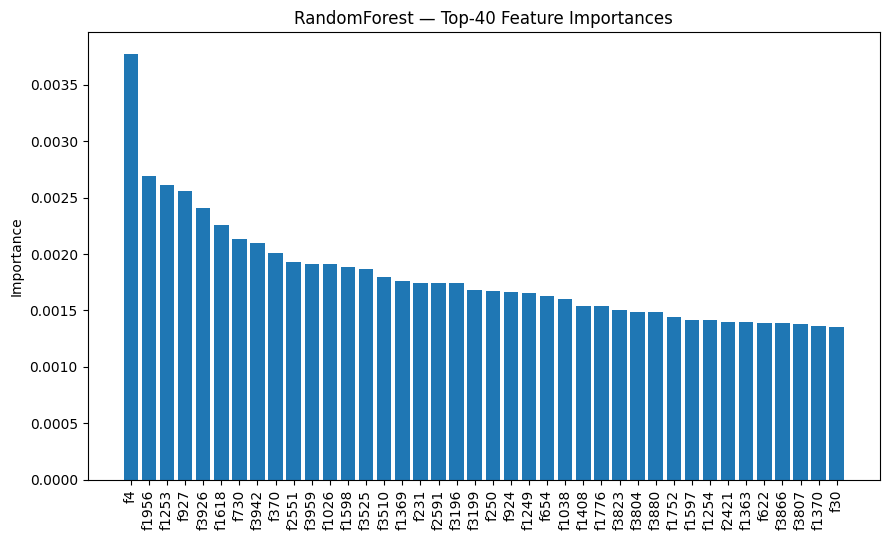

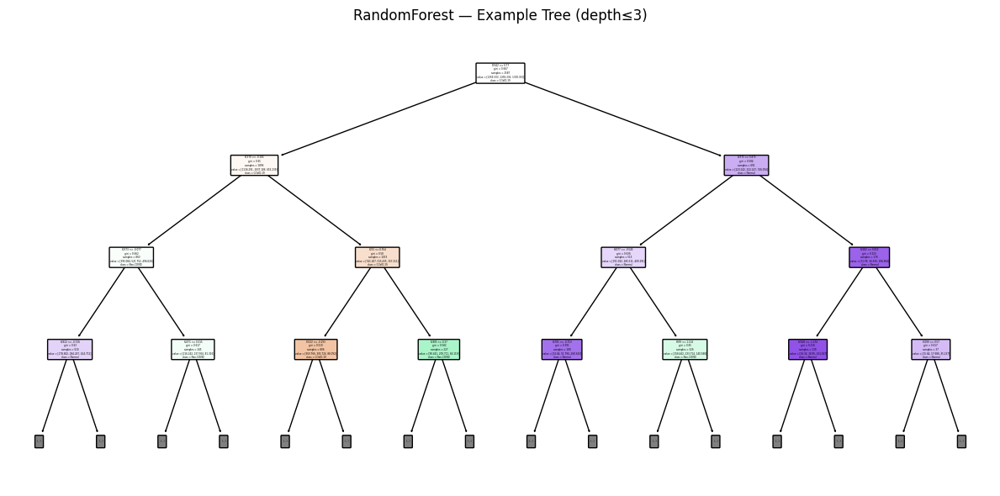

In [20]:
# Cell 11 — RF: Feature Importances (Top-N) & Shallow Tree
# Note: Importances mengacu pada fitur SETELAH SelectKBest (k=4096), bukan indeks HOG asli.
# Jika ingin mapping balik ke indeks HOG asli, perlu menyimpan selector.get_support(indices=True).

importances = rf.feature_importances_
N = min(40, importances.shape[0])
top_idx = np.argsort(importances)[::-1][:N]
top_vals = importances[top_idx]

plt.figure(figsize=(9,5.5))
plt.bar(range(N), top_vals)
plt.xticks(range(N), [f"f{int(i)}" for i in top_idx], rotation=90)
plt.ylabel("Importance"); plt.title(f"RandomForest — Top-{N} Feature Importances")
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"rf_feature_importances_top{N}_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()

# Visualisasi satu pohon dangkal
plt.figure(figsize=(12,6))
plot_tree(rf.estimators_[0], max_depth=3, filled=True, feature_names=[f"f{i}" for i in range(importances.shape[0])], class_names=[CLASSES[i] for i in [0,1,2]], rounded=True)
plt.title("RandomForest — Example Tree (depth≤3)")
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"rf_tree_depth3_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()


Langkah 2C (kNN): t-SNE 2D & Neighbor Inspection (5 tetangga terdekat)

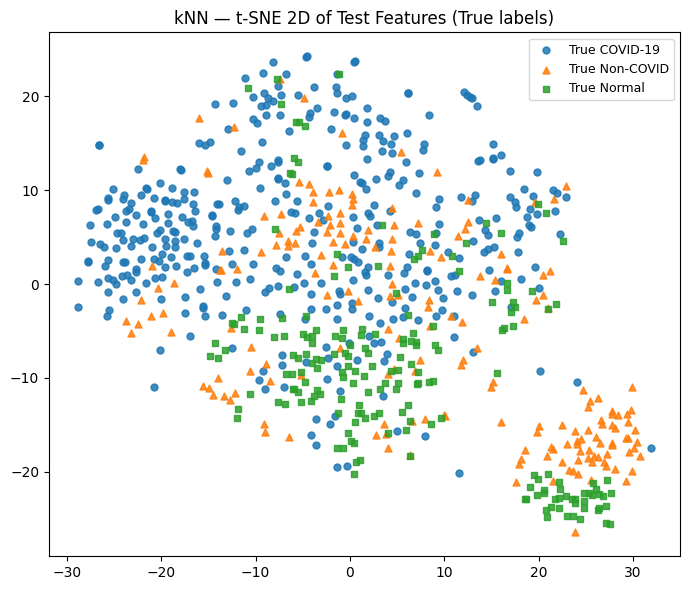

Jumlah salah kNN di test: 196


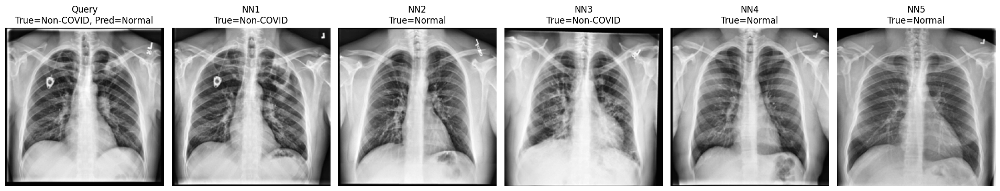

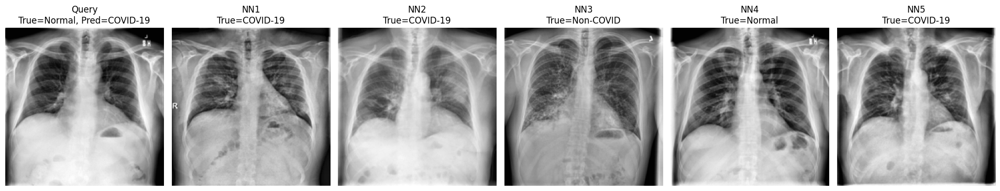

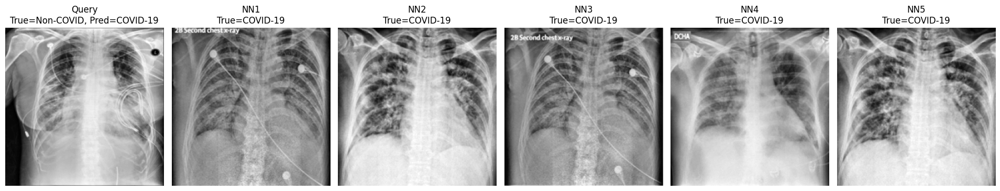

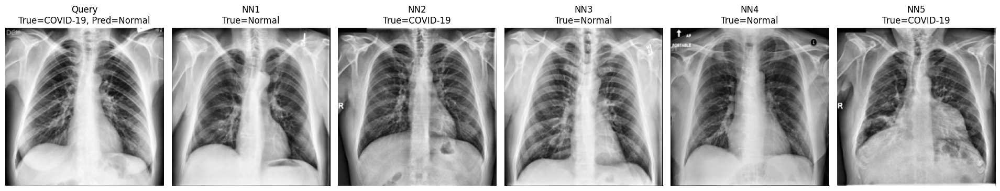

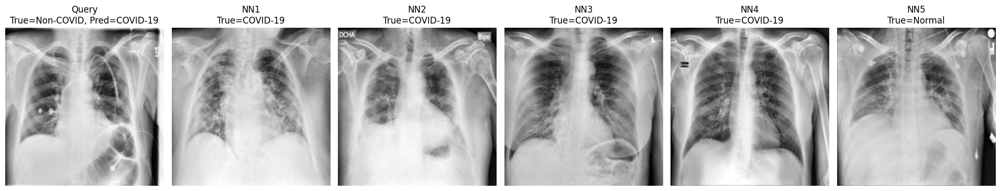

In [21]:
# Cell 12 — kNN: t-SNE (2D) & Neighbor Inspection
# t-SNE untuk test-set (cukup 500–1000 sampel bila perlu hemat waktu)
n_tsne = min(800, Xte.shape[0])
rng = np.random.RandomState(42)
sel = np.sort(rng.choice(np.arange(Xte.shape[0]), size=n_tsne, replace=False))

tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42)
Z_tsne = tsne.fit_transform(Xte[sel])

yhat_knn = knn.predict(Xte)
plt.figure(figsize=(7,6))
for cls, marker in zip([0,1,2], ["o","^","s"]):
    idx = (y_te[sel]==cls)
    plt.scatter(Z_tsne[idx,0], Z_tsne[idx,1], marker=marker, s=25, alpha=0.85, label=f"True {CLASSES[cls]}")
plt.title("kNN — t-SNE 2D of Test Features (True labels)")
plt.legend(fontsize=9)
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"knn_tsne_true_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()

# ---- Neighbor inspection (Query+5 Neighbors) pada sampel SALAH
def show_query_neighbors_kNN(qk, n_neighbors=5):
    """qk: index ke dalam Xte (bukan global)."""
    from sklearn.metrics.pairwise import pairwise_distances
    # Cari tetangga di ruang FIT KNN → gunakan fitur TRAIN (kNN mempelajari jarak di Xtr)
    D = pairwise_distances(Xte[qk][None, :], Xtr, metric="euclidean").ravel()
    nn_idx_rel = np.argsort(D)[:n_neighbors]  # index relatif di train_idx
    nn_global = train_idx[nn_idx_rel]

    ncols = n_neighbors + 1
    plt.figure(figsize=(3.2*ncols, 3.6))
    # Query
    plt.subplot(1, ncols, 1)
    plt.imshow(X[test_idx[qk]], cmap="gray")
    plt.title(f"Query\nTrue={CLASSES[int(y_te[qk])]}, Pred={CLASSES[int(yhat_knn[qk])]}")
    plt.axis("off")
    # Neighbors
    for j, ridx in enumerate(nn_global, start=2):
        plt.subplot(1, ncols, j)
        plt.imshow(X[ridx], cmap="gray")
        plt.title(f"NN{j-1}\nTrue={CLASSES[int(Y[ridx])]}")
        plt.axis("off")
    plt.tight_layout()
    plt.savefig(VIZ_STAGE4 / f"knn_query_{qk}_neighbors_{ts}.png", dpi=150, bbox_inches="tight")
    plt.show()

errors_knn = np.where(yhat_knn != y_te)[0]
print(f"Jumlah salah kNN di test: {len(errors_knn)}")
for q in errors_knn[:5]:   # tampilkan 5 kasus dulu (ubah sesuai kebutuhan)
    show_query_neighbors_kNN(q, n_neighbors=5)


Langkah 3: Visualisasi Kualitatif (Grid 5–10 contoh salah per model)

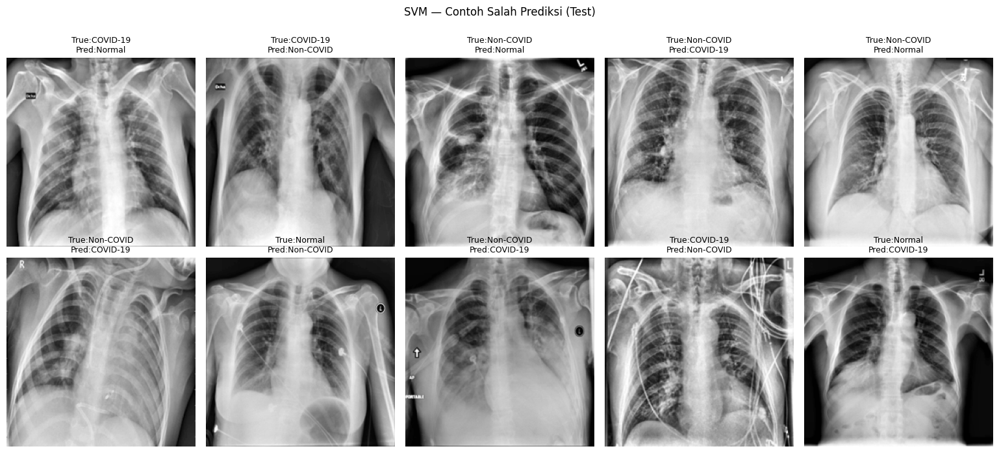

🖼️  Saved: artifacts/viz_stage4/errors_grid_svm_10_20251104-032919.png


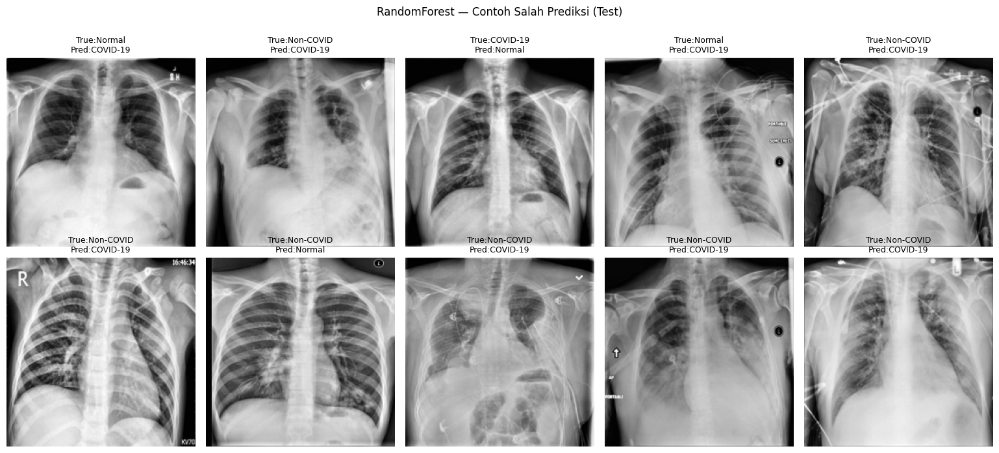

🖼️  Saved: artifacts/viz_stage4/errors_grid_randomforest_10_20251104-032919.png


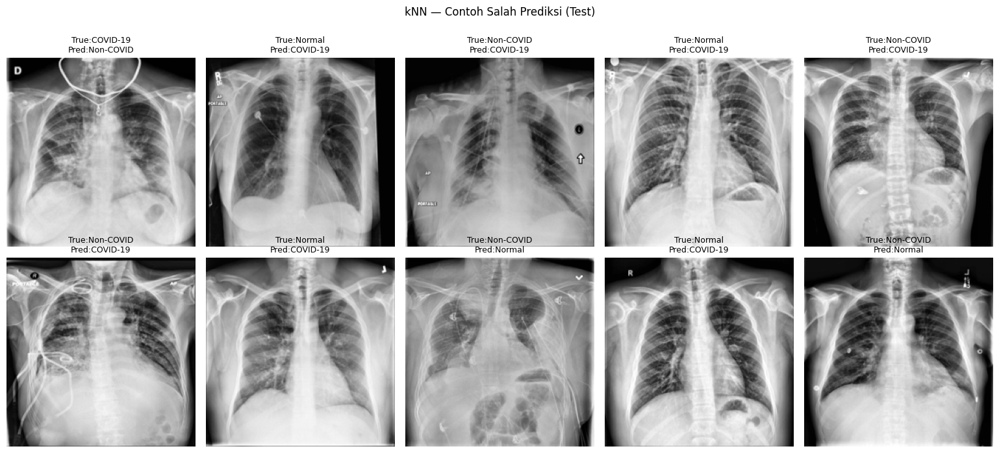

🖼️  Saved: artifacts/viz_stage4/errors_grid_knn_10_20251104-032919.png


In [22]:
# Cell 13 — Grid contoh salah prediksi (per model)
def plot_error_grid(model_name, y_true, y_pred, n=10, seed=7):
    rng = np.random.RandomState(seed)
    errs = np.where(y_true != y_pred)[0]
    if len(errs)==0:
        print(f"Tidak ada error untuk {model_name}")
        return
    sel = errs if len(errs) <= n else np.sort(rng.choice(errs, size=n, replace=False))
    rows = int(np.ceil(len(sel)/5)); cols = min(5, len(sel))
    plt.figure(figsize=(3.1*cols, 3.4*rows))
    for k, i in enumerate(sel, 1):
        plt.subplot(rows, cols, k)
        plt.imshow(X[test_idx[i]], cmap="gray")
        plt.title(f"True:{CLASSES[int(y_true[i])]}\nPred:{CLASSES[int(y_pred[i])]}", fontsize=9)
        plt.axis("off")
    plt.suptitle(f"{model_name} — Contoh Salah Prediksi (Test)", y=1.02)
    plt.tight_layout()
    path = VIZ_STAGE4 / f"errors_grid_{model_name.lower()}_{len(sel)}_{ts}.png"
    plt.savefig(path, dpi=150, bbox_inches="tight")
    plt.show()
    print("🖼️  Saved:", path)

yhat_svm = svm.predict(Xte)
yhat_rf  = rf.predict(Xte)
yhat_knn = knn.predict(Xte)

plot_error_grid("SVM", y_te, yhat_svm, n=10, seed=11)
plot_error_grid("RandomForest", y_te, yhat_rf, n=10, seed=11)
plot_error_grid("kNN", y_te, yhat_knn, n=10, seed=11)


Langkah 4: Analisis Lintas Model (Overlap kasus salah & ringkasan tabel)

,group,count
0,Only SVM,12
1,Only RF,47
2,Only kNN,43
3,SVM∩RF,15
4,SVM∩kNN,6
5,RF∩kNN,60
6,SVM∩RF∩kNN,87


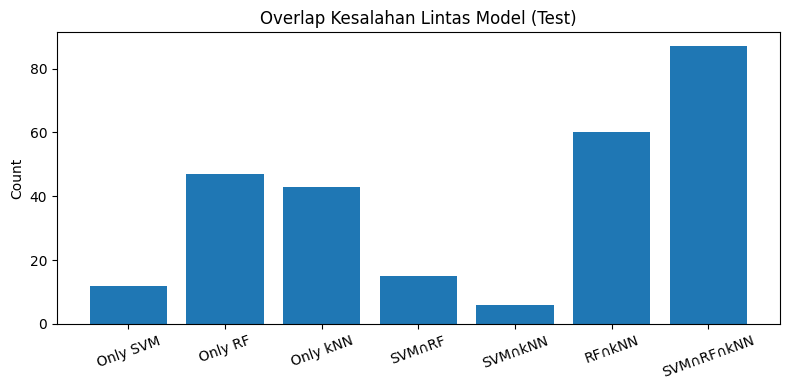

🗒️  Saved: artifacts/viz_stage4/indices_only_svm_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_only_rf_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_only_knn_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_svm_and_rf_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_svm_and_knn_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_rf_and_knn_20251104-032919.csv
🗒️  Saved: artifacts/viz_stage4/indices_all_three_20251104-032919.csv


In [23]:
# Cell 14 — Cross-Model Error Analysis
err_svm = set(np.where(yhat_svm != y_te)[0])
err_rf  = set(np.where(yhat_rf  != y_te)[0])
err_knn = set(np.where(yhat_knn != y_te)[0])

only_svm = err_svm - (err_rf | err_knn)
only_rf  = err_rf  - (err_svm | err_knn)
only_knn = err_knn - (err_svm | err_rf)
svm_rf   = (err_svm & err_rf) - err_knn
svm_knn  = (err_svm & err_knn) - err_rf
rf_knn   = (err_rf  & err_knn) - err_svm
all_3    = err_svm & err_rf & err_knn

rows = [
    {"group":"Only SVM", "count":len(only_svm)},
    {"group":"Only RF",  "count":len(only_rf)},
    {"group":"Only kNN", "count":len(only_knn)},
    {"group":"SVM∩RF",   "count":len(svm_rf)},
    {"group":"SVM∩kNN",  "count":len(svm_knn)},
    {"group":"RF∩kNN",   "count":len(rf_knn)},
    {"group":"SVM∩RF∩kNN","count":len(all_3)},
]
df_overlap = pd.DataFrame(rows)
display(df_overlap)

# Bar chart overlap
plt.figure(figsize=(8,4))
plt.bar(df_overlap["group"], df_overlap["count"])
plt.xticks(rotation=20)
plt.ylabel("Count"); plt.title("Overlap Kesalahan Lintas Model (Test)")
plt.tight_layout()
plt.savefig(VIZ_STAGE4 / f"cross_model_overlap_{ts}.png", dpi=150, bbox_inches="tight")
plt.show()

# Simpan daftar index untuk lampiran (dengan path & label)
def dump_index_set(name, idx_set):
    idx = sorted(list(idx_set))
    dump = pd.DataFrame({
        "te_index": idx,
        "path": paths_te[idx],
        "true": [CLASSES[int(y_te[i])] for i in idx],
        "svm_pred": [CLASSES[int(yhat_svm[i])] for i in idx],
        "rf_pred":  [CLASSES[int(yhat_rf[i])]  for i in idx],
        "knn_pred": [CLASSES[int(yhat_knn[i])] for i in idx],
    })
    p = VIZ_STAGE4 / f"indices_{name}_{ts}.csv"
    dump.to_csv(p, index=False); print("🗒️  Saved:", p)

dump_index_set("only_svm", only_svm)
dump_index_set("only_rf", only_rf)
dump_index_set("only_knn", only_knn)
dump_index_set("svm_and_rf", svm_rf)
dump_index_set("svm_and_knn", svm_knn)
dump_index_set("rf_and_knn", rf_knn)
dump_index_set("all_three", all_3)


Langkah 5: Tabel Ringkasan & Rekomendasi (otomatis dari metrik + deskripsi)

In [24]:
# Cell 15 — Ringkasan & Rekomendasi (generate tabel final)
def model_row(name, y_true, y_pred):
    acc = accuracy_score(y_true, y_pred)
    prec, rec, f1, _ = precision_recall_fscore_support(y_true, y_pred, average="macro", zero_division=0)
    return {"Model":name, "Accuracy":acc, "Precision (Macro)":prec, "Recall (Macro)":rec, "F1 (Macro)":f1}

sum_rows = [
    model_row("SVM RBF", y_te, yhat_svm),
    model_row("Random Forest", y_te, yhat_rf),
    model_row("kNN", y_te, yhat_knn),
]
df_summary = pd.DataFrame(sum_rows).sort_values("F1 (Macro)", ascending=False)
display(df_summary)
df_summary.to_csv(VIZ_STAGE4 / f"final_summary_metrics_{ts}.csv", index=False)
print("🗒️  Saved:", VIZ_STAGE4 / f"final_summary_metrics_{ts}.csv")

# Tabel naratif (static, bisa kamu edit sesuai hasil)
narrative = pd.DataFrame({
    "Aspek": [
        "Kinerja Umum",
        "Tipe Kesalahan Dominan",
        "Kelebihan",
        "Kelemahan",
        "Pendekatan Analisis",
        "Saran Perbaikan"
    ],
    "SVM RBF": [
        "Terbaik & stabil (F1 macro tertinggi).",
        "Borderline overlap COVID–Non-COVID (margin sempit).",
        "Separasi kuat, robust terhadap variasi moderat.",
        "Kurang interpretabel fitur-asli.",
        "PCA/t-SNE + boundary 2D, histogram confidence.",
        "Tambahkan fitur semantik (CNN) / ensembel."
    ],
    "Random Forest": [
        "Baik namun di bawah SVM.",
        "Terpengaruh artefak intensitas/tepi (tube, kabel).",
        "Interpretabilitas via feature_importances_ & tree.",
        "Bisa fokus ke fitur tak relevan.",
        "Bar chart feature importance, tree depth≤3.",
        "Kurangi fitur redundan; cek artefak (augment/filter)."
    ],
    "kNN": [
        "Cukup (sensitif noise).",
        "Salah di tepi cluster (overlap antar kelas).",
        "Sederhana; tak butuh training berat.",
        "Curse of dimensionality; sensitif skala.",
        "t-SNE + inspeksi 5 tetangga terdekat.",
        "Reduksi dimensi (PCA), tuning k & metric."
    ]
})
display(narrative)
narrative.to_csv(VIZ_STAGE4 / f"narrative_recap_{ts}.csv", index=False)
print("🗒️  Saved narrative table.")


,Model,Accuracy,Precision (Macro),Recall (Macro),F1 (Macro)
0,SVM RBF,0.862700,0.860148,0.832272,0.843246
2,kNN,0.775744,0.784148,0.722516,0.738887
1,Random Forest,0.760870,0.806633,0.696612,0.718847


🗒️  Saved: artifacts/viz_stage4/final_summary_metrics_20251104-032919.csv


,Aspek,SVM RBF,Random Forest,kNN
0,Kinerja Umum,Terbaik & stabil (F1 macro tertinggi).,Baik namun di bawah SVM.,Cukup (sensitif noise).
1,Tipe Kesalahan Dominan,Borderline overlap COVID–Non-COVID (margin sem...,"Terpengaruh artefak intensitas/tepi (tube, kab...",Salah di tepi cluster (overlap antar kelas).
2,Kelebihan,"Separasi kuat, robust terhadap variasi moderat.",Interpretabilitas via feature_importances_ & t...,Sederhana; tak butuh training berat.
3,Kelemahan,Kurang interpretabel fitur-asli.,Bisa fokus ke fitur tak relevan.,Curse of dimensionality; sensitif skala.
4,Pendekatan Analisis,"PCA/t-SNE + boundary 2D, histogram confidence.","Bar chart feature importance, tree depth≤3.",t-SNE + inspeksi 5 tetangga terdekat.
5,Saran Perbaikan,Tambahkan fitur semantik (CNN) / ensembel.,Kurangi fitur redundan; cek artefak (augment/f...,"Reduksi dimensi (PCA), tuning k & metric."


🗒️  Saved narrative table.


**REVISI TAHAP 4**

In [25]:
# SEL0 — Guard: pastikan artefak & hyperparameter sesuai
import os, json, joblib, numpy as np, pandas as pd, matplotlib.pyplot as plt
from pathlib import Path
from datetime import datetime
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier

ARTIFACTS = Path("./artifacts"); ARTIFACTS.mkdir(parents=True, exist_ok=True)
VIZ_STAGE4 = ARTIFACTS / "viz_stage4"; VIZ_STAGE4.mkdir(parents=True, exist_ok=True)
ts = datetime.now().strftime("%Y%m%d-%H%M%S")

try: CLASSES
except NameError: CLASSES = {0:"COVID-19", 1:"Non-COVID", 2:"Normal"}

# Muat model yang sudah kamu latih
clf_dir = ARTIFACTS / "classic_models"
svm = joblib.load(clf_dir/"svm_rbf.joblib")
rf  = joblib.load(clf_dir/"random_forest.joblib")
knn = joblib.load(clf_dir/"knn.joblib")

assert isinstance(svm, SVC) and svm.kernel=="rbf" and svm.C==10 and svm.class_weight=="balanced" and getattr(svm,"probability",False), "SVM RBF spec mismatch"
assert isinstance(rf, RandomForestClassifier) and rf.n_estimators==300 and rf.class_weight=="balanced_subsample", "RF spec mismatch"
assert isinstance(knn, KNeighborsClassifier) and knn.n_neighbors==5, "kNN spec mismatch"

def safe_proba(model, X):
    if hasattr(model, "predict_proba"): return model.predict_proba(X)
    if hasattr(model, "decision_function"):
        z = model.decision_function(X); z = np.atleast_2d(z)
        z = z - z.max(axis=1, keepdims=True); ez = np.exp(z)
        return ez/ez.sum(axis=1, keepdims=True)
    K = 3
    return np.ones((len(X), K))/K
print("✅ Guard OK. Model & hyperparameter sesuai.")


✅ Guard OK. Model & hyperparameter sesuai.


In [26]:
# SEL1 — Loader robust
from sklearn.metrics import (confusion_matrix, classification_report, 
                             precision_recall_fscore_support, accuracy_score, average_precision_score, roc_auc_score)
ARTIFACTS.mkdir(exist_ok=True, parents=True)

arr_path    = ARTIFACTS / "processed_infection.npz"
splits_path = ARTIFACTS / "splits.npz"
hog_path    = ARTIFACTS / "hog_features.npz"

data_npz = np.load(arr_path, allow_pickle=True)
X, Y = data_npz["X"], data_npz["Y"]
paths_all = data_npz["paths"] if "paths" in data_npz.files else np.array([f"idx_{i}" for i in range(len(X))])

spl = np.load(splits_path, allow_pickle=True)
train_idx, val_idx, test_idx = spl["train_idx"], spl["val_idx"], spl["test_idx"]

X_hog = np.load(hog_path)["X_hog"]
selector = joblib.load(ARTIFACTS/"feature_selector.joblib")
scaler   = joblib.load(ARTIFACTS/"feature_scaler.joblib")

def transform_feat(Xhog): return scaler.transform(selector.transform(Xhog))

Xtr, Xva, Xte = transform_feat(X_hog[train_idx]), transform_feat(X_hog[val_idx]), transform_feat(X_hog[test_idx])
y_tr, y_va, y_te = Y[train_idx], Y[val_idx], Y[test_idx]
paths_te = paths_all[test_idx]

print("✅ Loaded: Xtr/Xva/Xte", Xtr.shape, Xva.shape, Xte.shape)


✅ Loaded: Xtr/Xva/Xte (4078, 4096) (874, 4096) (874, 4096)


In [27]:
# SEL2 — Per-sample predictions (Test) + confidence p_max
from datetime import datetime
def _lbl(k): return CLASSES[int(k)]

def _df_for_model(name, clf, X, y, paths):
    proba = safe_proba(clf, X)
    yhat  = proba.argmax(axis=1)
    return pd.DataFrame({
        "model": name,
        "path": paths,
        "true_id": y,
        "true": [_lbl(t) for t in y],
        "pred_id": yhat,
        "pred": [_lbl(p) for p in yhat],
        "prob_max": proba.max(axis=1),
        "prob_argmax_id": proba.argmax(axis=1),
        "prob_COVID-19": proba[:,0],
        "prob_Non-COVID": proba[:,1],
        "prob_Normal": proba[:,2],
        "is_correct": (yhat==y)
    })

df_svm = _df_for_model("SVM-RBF", svm, Xte, y_te, paths_te)
df_rf  = _df_for_model("RandomForest", rf,  Xte, y_te, paths_te)
df_knn = _df_for_model("kNN",      knn, Xte, y_te, paths_te)
df_stage4_all = pd.concat([df_svm, df_rf, df_knn], ignore_index=True)

stage4_csv = VIZ_STAGE4/f"stage4_test_predictions_with_proba_{ts}.csv"
df_stage4_all.to_csv(stage4_csv, index=False)
print("🗒️ Saved:", stage4_csv)
display(df_stage4_all.head())


🗒️ Saved: artifacts/viz_stage4/stage4_test_predictions_with_proba_20251104-033038.csv


,model,path,true_id,true,pred_id,pred,prob_max,prob_argmax_id,prob_COVID-19,prob_Non-COVID,prob_Normal,is_correct
0,SVM-RBF,/kaggle/input/covidqu/Infection Segmentation D...,0,COVID-19,0,COVID-19,0.866314,0,0.866314,0.096047,0.037639,True
1,SVM-RBF,/kaggle/input/covidqu/Infection Segmentation D...,0,COVID-19,0,COVID-19,0.976849,0,0.976849,0.011087,0.012064,True
2,SVM-RBF,/kaggle/input/covidqu/Infection Segmentation D...,0,COVID-19,0,COVID-19,0.953646,0,0.953646,0.017761,0.028594,True
3,SVM-RBF,/kaggle/input/covidqu/Infection Segmentation D...,0,COVID-19,2,Normal,0.490775,2,0.230829,0.278396,0.490775,False
4,SVM-RBF,/kaggle/input/covidqu/Infection Segmentation D...,1,Non-COVID,0,COVID-19,0.578150,0,0.578150,0.365813,0.056037,False


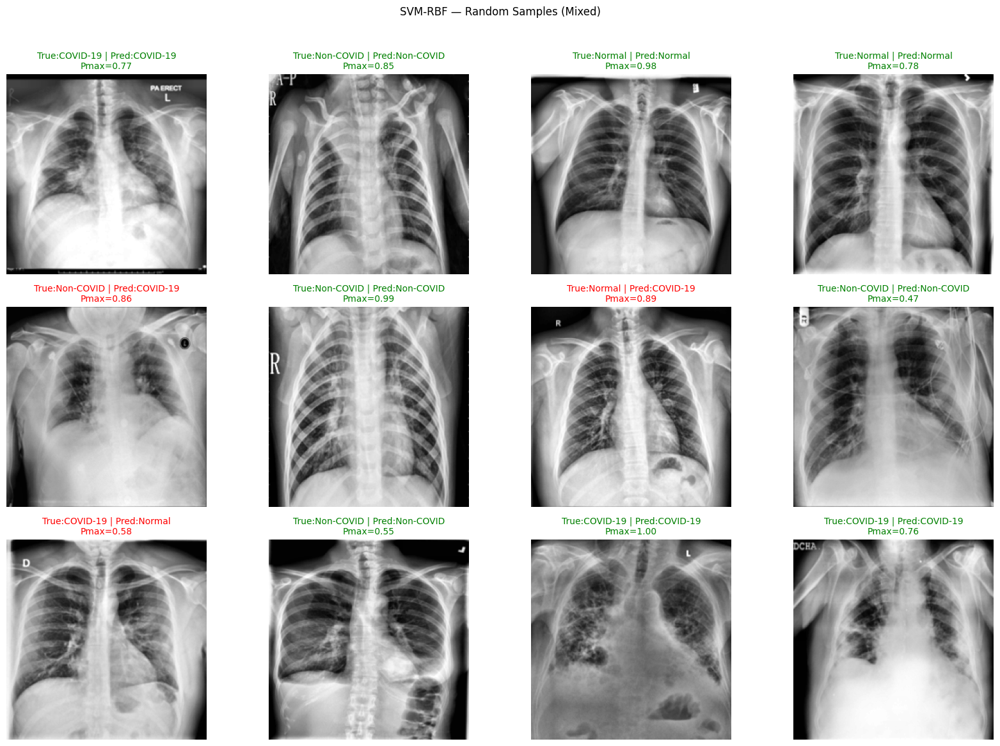

🖼️ Saved: artifacts/viz_stage4/grid_random_svmrbf_mixed_12_20251104-033038.png


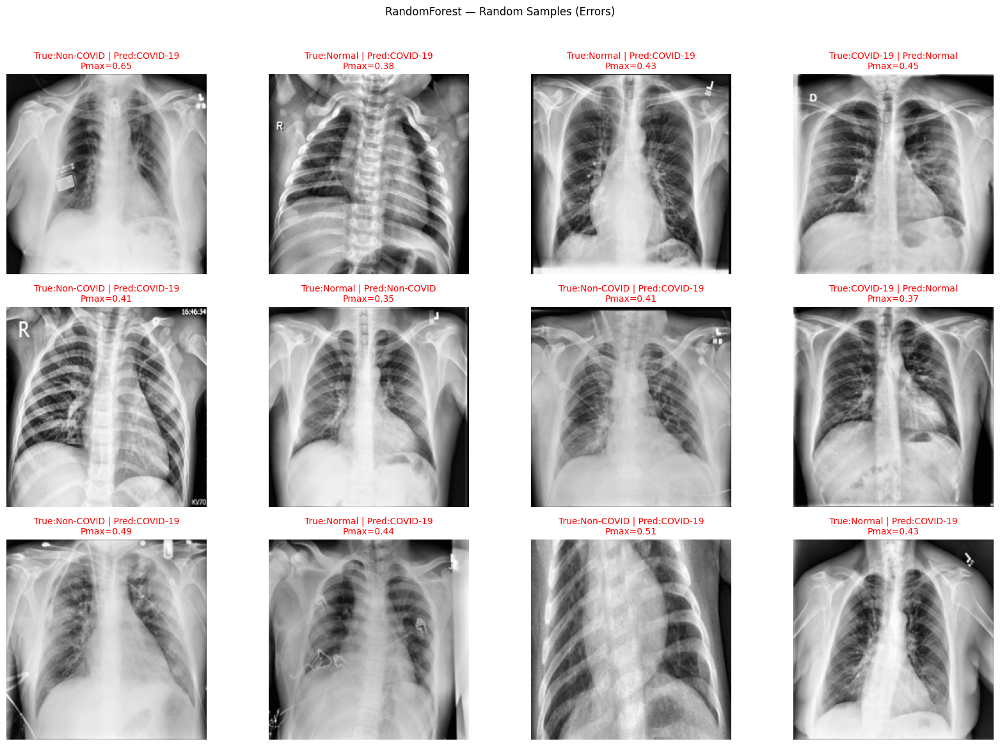

🖼️ Saved: artifacts/viz_stage4/grid_random_randomforest_errors_12_20251104-033038.png


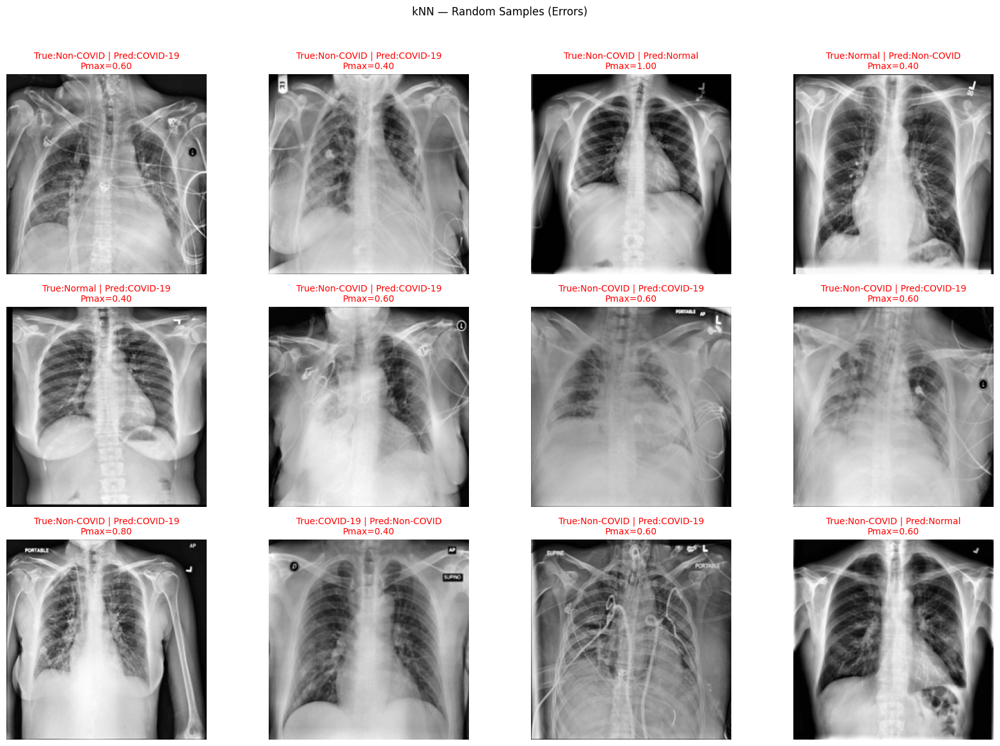

🖼️ Saved: artifacts/viz_stage4/grid_random_knn_errors_12_20251104-033038.png


In [28]:
# SEL3 — Random sampling helpers + grid
import matplotlib.pyplot as plt

def sample_predictions(df_all, model_name="SVM-RBF", n=12, errors_only=False, seed=7):
    rng = np.random.RandomState(seed)
    sub = df_all[df_all["model"]==model_name].copy()
    if errors_only: sub=sub[~sub["is_correct"]]
    if len(sub)==0: raise ValueError(f"Tidak ada sampel (model={model_name}, errors_only={errors_only}).")
    take = min(n, len(sub)); idx = rng.choice(sub.index.values, size=take, replace=False)
    return sub.loc[idx].reset_index(drop=True)

def plot_random_sample_grid(df_all, model_name="SVM-RBF", n=12, errors_only=False, seed=7):
    df_s = sample_predictions(df_all, model_name, n, errors_only, seed)
    # mapping path → posisi test untuk ambil gambar
    path_to_testpos = {p:i for i,p in enumerate(paths_te)}
    n_show = len(df_s); cols = 4 if n_show>=4 else n_show; rows = int(np.ceil(n_show/cols))
    plt.figure(figsize=(4.2*cols, 3.8*rows))
    for k,row in enumerate(df_s.itertuples(index=False),1):
        pos = path_to_testpos.get(row.path, None)
        img = X[test_idx[pos]] if pos is not None else np.zeros_like(X[0])
        plt.subplot(rows, cols, k)
        plt.imshow(img, cmap="gray")
        title = f"True:{row.true} | Pred:{row.pred}\nPmax={row.prob_max:.2f}"
        plt.title(title, color=("green" if row.is_correct else "red"), fontsize=10)
        plt.axis("off")
    plt.suptitle(f"{model_name} — Random Samples ({'Errors' if errors_only else 'Mixed'})", y=1.02)
    plt.tight_layout()
    outp = VIZ_STAGE4/f"grid_random_{model_name.replace('-','').lower()}_{'errors' if errors_only else 'mixed'}_{n}_{ts}.png"
    plt.savefig(outp, dpi=150, bbox_inches="tight"); plt.show()
    print("🖼️ Saved:", outp)

# Contoh:
plot_random_sample_grid(df_stage4_all, "SVM-RBF",     n=12, errors_only=False, seed=11)
plot_random_sample_grid(df_stage4_all, "RandomForest", n=12, errors_only=True,  seed=99)
plot_random_sample_grid(df_stage4_all, "kNN",          n=12, errors_only=True,  seed=99)


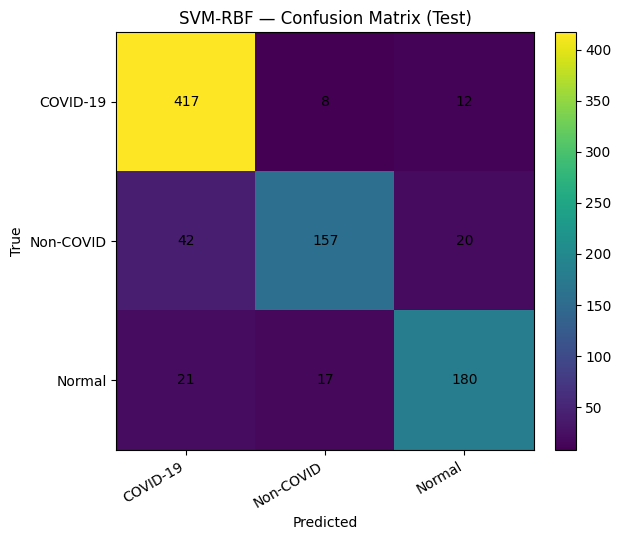

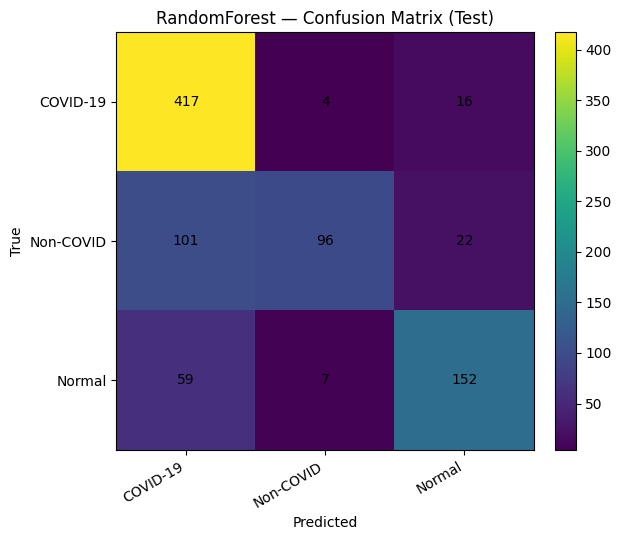

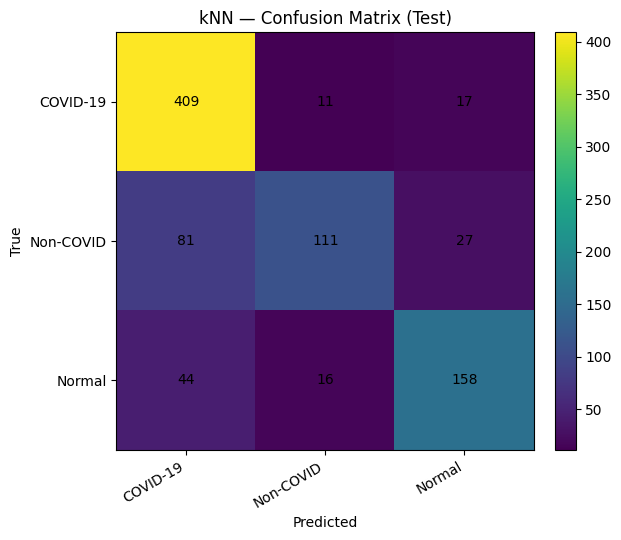

,model,accuracy,precision_macro,recall_macro,f1_macro
0,SVM-RBF,0.862700,0.860148,0.832272,0.843246
2,kNN,0.775744,0.784148,0.722516,0.738887
1,RandomForest,0.760870,0.806633,0.696612,0.718847


🗒️ Saved: artifacts/viz_stage4/stage4_basic_stats_20251104-033038.csv


In [29]:
# SEL4 — CM + classification report (Test)
def plot_cm(cm, title, savepath=None):
    plt.figure(figsize=(6.5,5.5))
    im = plt.imshow(cm, interpolation="nearest")
    plt.title(title); plt.colorbar(im, fraction=0.046, pad=0.04)
    ticks = [CLASSES[i] for i in [0,1,2]]
    plt.xticks(range(3), ticks, rotation=30, ha="right"); plt.yticks(range(3), ticks)
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            plt.text(j, i, str(cm[i,j]), ha="center", va="center", fontsize=10)
    plt.xlabel("Predicted"); plt.ylabel("True")
    plt.tight_layout(); 
    if savepath: plt.savefig(savepath, dpi=150, bbox_inches="tight")
    plt.show()

rows=[]
for name, clf in [("SVM-RBF",svm),("RandomForest",rf),("kNN",knn)]:
    yhat = clf.predict(Xte)
    cm = confusion_matrix(y_te, yhat, labels=[0,1,2])
    rep = classification_report(y_te, yhat, output_dict=True, zero_division=0)
    acc = accuracy_score(y_te, yhat)
    p,r,f1,_ = precision_recall_fscore_support(y_te, yhat, average="macro", zero_division=0)
    rows.append({"model":name,"accuracy":acc,"precision_macro":p,"recall_macro":r,"f1_macro":f1})
    plot_cm(cm, f"{name} — Confusion Matrix (Test)", VIZ_STAGE4/f"cm_{name.replace('-','').lower()}_{ts}.png")
    with open(VIZ_STAGE4/f"classification_report_{name.replace('-','').lower()}_{ts}.json","w") as f:
        json.dump(rep, f, indent=2)

df_stats = pd.DataFrame(rows).sort_values("f1_macro", ascending=False)
display(df_stats)
df_stats.to_csv(VIZ_STAGE4/f"stage4_basic_stats_{ts}.csv", index=False)
print("🗒️ Saved:", VIZ_STAGE4/f"stage4_basic_stats_{ts}.csv")


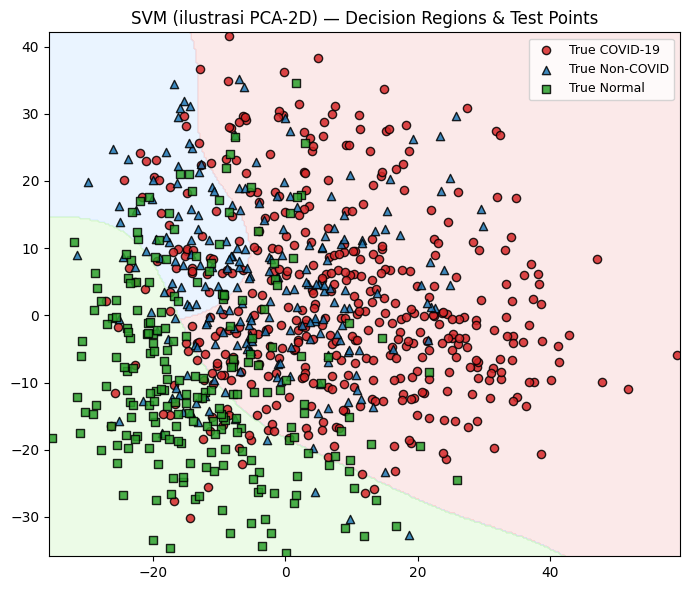

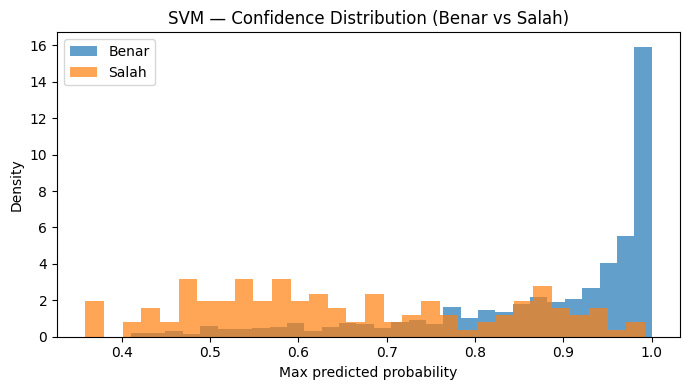

In [30]:
# SEL5 — SVM: PCA 2D + confidence histogram
from sklearn.decomposition import PCA
from sklearn.svm import SVC
from matplotlib.colors import ListedColormap

pca = PCA(n_components=2, random_state=42)
Z_te_2d = pca.fit_transform(Xte)

svm_2d = SVC(kernel="rbf", C=10, gamma="scale", probability=True, random_state=42)
svm_2d.fit(Z_te_2d, y_te)

x_min,x_max = Z_te_2d[:,0].min()-0.5, Z_te_2d[:,0].max()+0.5
y_min,y_max = Z_te_2d[:,1].min()-0.5, Z_te_2d[:,1].max()+0.5
xx,yy = np.meshgrid(np.linspace(x_min,x_max,300), np.linspace(y_min,y_max,300))
ZZ = svm_2d.predict(np.c_[xx.ravel(),yy.ravel()]).reshape(xx.shape)

cmap_bg = ListedColormap(["#f7cac9","#cce5ff","#d1f7c4"])
plt.figure(figsize=(7,6))
plt.contourf(xx,yy,ZZ,alpha=0.4,cmap=cmap_bg)
yhat_full = svm.predict(Xte)
for cls, marker, color in [(0,"o","#d62728"),(1,"^","#1f77b4"),(2,"s","#2ca02c")]:
    idx = (y_te==cls)
    plt.scatter(Z_te_2d[idx,0], Z_te_2d[idx,1], c=color, marker=marker, s=35, alpha=0.85, edgecolor="k", label=f"True {CLASSES[cls]}")
plt.title("SVM (ilustrasi PCA-2D) — Decision Regions & Test Points"); plt.legend(fontsize=9)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"svm_pca2d_boundary_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

proba_svm = safe_proba(svm, Xte)
maxp = proba_svm.max(axis=1); correct = (yhat_full==y_te)
plt.figure(figsize=(7,4))
plt.hist(maxp[correct], bins=30, alpha=0.7, label="Benar", density=True)
plt.hist(maxp[~correct], bins=30, alpha=0.7, label="Salah", density=True)
plt.xlabel("Max predicted probability"); plt.ylabel("Density")
plt.title("SVM — Confidence Distribution (Benar vs Salah)"); plt.legend()
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"svm_confidence_hist_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()


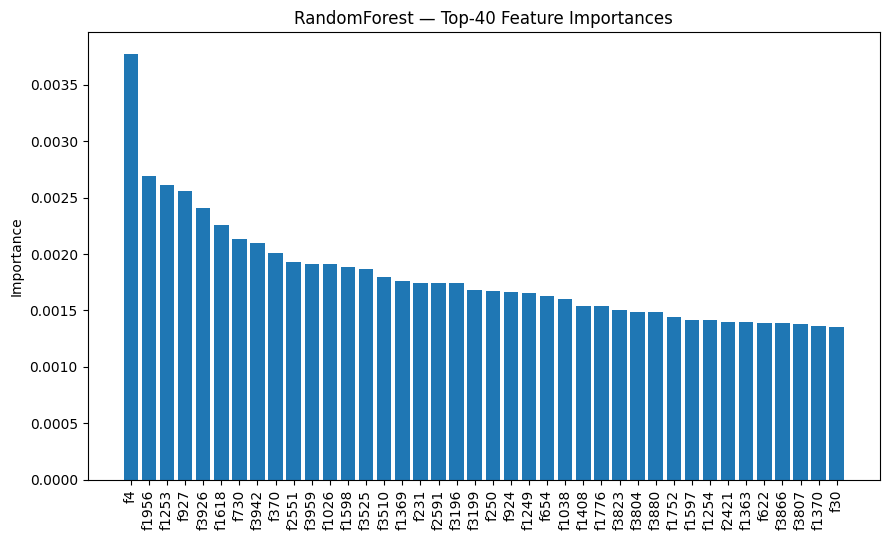

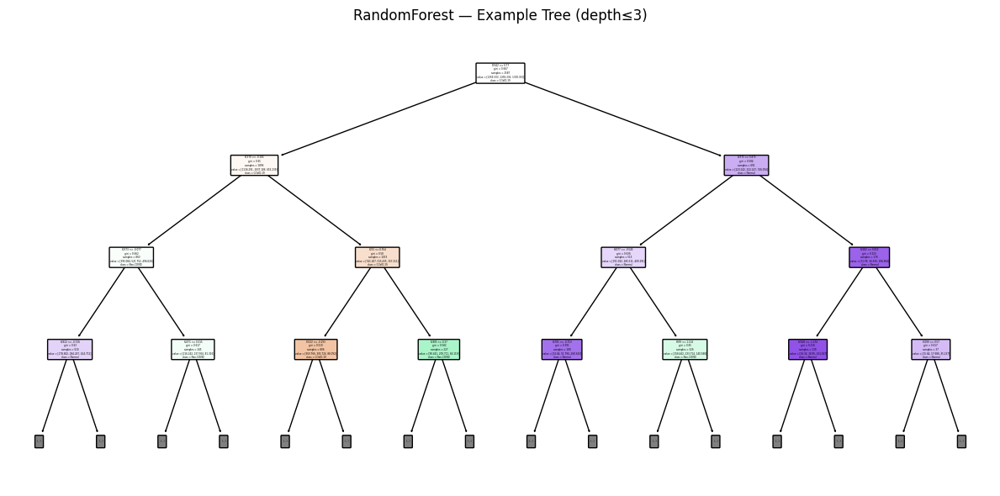

In [31]:
# SEL6 — RF: Feature importances + shallow tree
from sklearn.tree import plot_tree

imps = rf.feature_importances_
N = min(40, imps.size); top_idx = np.argsort(imps)[::-1][:N]; top_vals = imps[top_idx]

plt.figure(figsize=(9,5.5))
plt.bar(range(N), top_vals)
plt.xticks(range(N), [f"f{int(i)}" for i in top_idx], rotation=90)
plt.ylabel("Importance"); plt.title(f"RandomForest — Top-{N} Feature Importances")
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"rf_feature_importances_top{N}_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

plt.figure(figsize=(12,6))
plot_tree(rf.estimators_[0], max_depth=3, filled=True,
          feature_names=[f"f{i}" for i in range(imps.size)],
          class_names=[CLASSES[i] for i in [0,1,2]], rounded=True)
plt.title("RandomForest — Example Tree (depth≤3)")
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"rf_tree_depth3_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()


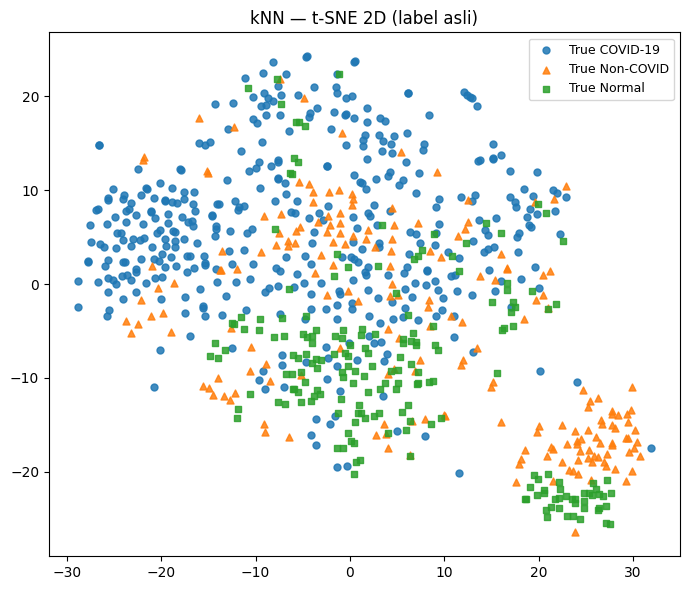

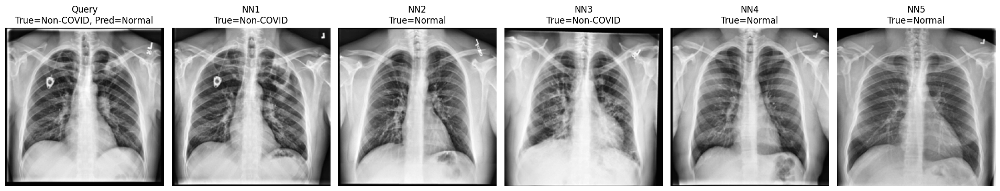

🖼️ artifacts/viz_stage4/knn_query_12_neighbors_20251104-033038.png


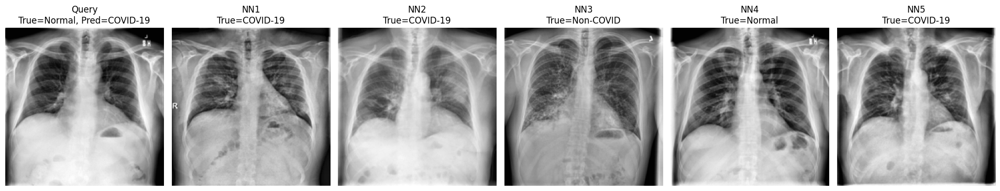

🖼️ artifacts/viz_stage4/knn_query_14_neighbors_20251104-033038.png


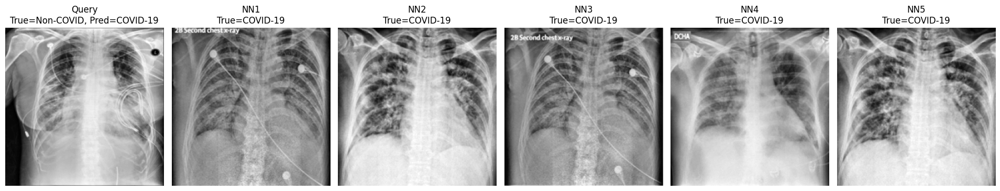

🖼️ artifacts/viz_stage4/knn_query_15_neighbors_20251104-033038.png


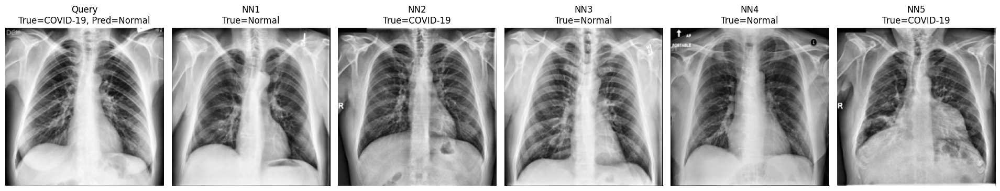

🖼️ artifacts/viz_stage4/knn_query_20_neighbors_20251104-033038.png


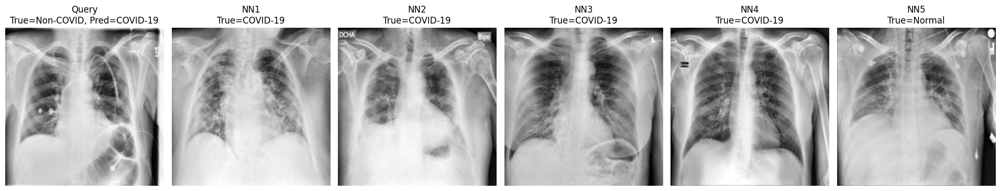

🖼️ artifacts/viz_stage4/knn_query_22_neighbors_20251104-033038.png


In [32]:
# SEL7 — kNN: t-SNE + neighbors
from sklearn.manifold import TSNE
from sklearn.metrics.pairwise import pairwise_distances

n_tsne = min(800, Xte.shape[0])
sel = np.sort(np.random.RandomState(42).choice(np.arange(Xte.shape[0]), size=n_tsne, replace=False))
Z_tsne = TSNE(n_components=2, perplexity=30, learning_rate='auto', init='pca', random_state=42).fit_transform(Xte[sel])

yhat_knn = knn.predict(Xte)
plt.figure(figsize=(7,6))
for cls, marker in [(0,"o"),(1,"^"),(2,"s")]:
    idx = (y_te[sel]==cls)
    plt.scatter(Z_tsne[idx,0], Z_tsne[idx,1], marker=marker, s=25, alpha=0.85, label=f"True {CLASSES[cls]}")
plt.title("kNN — t-SNE 2D (label asli)"); plt.legend(fontsize=9)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"knn_tsne_true_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

def show_query_neighbors_kNN(qk, n_neighbors=5):
    D = pairwise_distances(Xte[qk][None,:], Xtr, metric="euclidean").ravel()
    nn_rel = np.argsort(D)[:n_neighbors]  # indeks relatif di train_idx
    nn_global = train_idx[nn_rel]
    ncols = n_neighbors + 1
    plt.figure(figsize=(3.2*ncols, 3.6))
    plt.subplot(1,ncols,1); plt.imshow(X[test_idx[qk]], cmap="gray")
    plt.title(f"Query\nTrue={CLASSES[int(y_te[qk])]}, Pred={CLASSES[int(yhat_knn[qk])]}"); plt.axis("off")
    for j, ridx in enumerate(nn_global, start=2):
        plt.subplot(1,ncols,j); plt.imshow(X[ridx], cmap="gray")
        plt.title(f"NN{j-1}\nTrue={CLASSES[int(Y[ridx])]}"); plt.axis("off")
    plt.tight_layout(); 
    p = VIZ_STAGE4/f"knn_query_{qk}_neighbors_{ts}.png"
    plt.savefig(p, dpi=150, bbox_inches="tight"); plt.show(); print("🖼️", p)

errors_knn = np.where(yhat_knn != y_te)[0]
for q in errors_knn[:5]:  # tampilkan 5 dulu
    show_query_neighbors_kNN(q, n_neighbors=5)


,group,count
0,Only SVM,12
1,Only RF,47
2,Only kNN,43
3,SVM∩RF,15
4,SVM∩kNN,6
5,RF∩kNN,60
6,SVM∩RF∩kNN,87


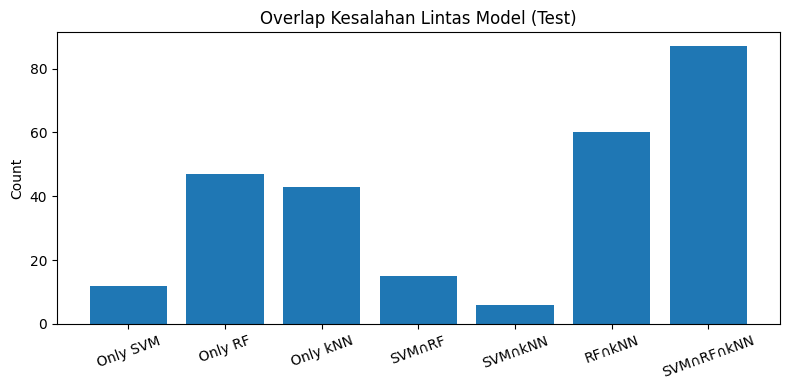

🗒️ Saved: artifacts/viz_stage4/indices_only_svm_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_only_rf_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_only_knn_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_svm_and_rf_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_svm_and_knn_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_rf_and_knn_20251104-033038.csv
🗒️ Saved: artifacts/viz_stage4/indices_all_three_20251104-033038.csv


In [33]:
# SEL8 — Cross-model error overlap
yhat_svm = svm.predict(Xte); yhat_rf = rf.predict(Xte); yhat_knn = knn.predict(Xte)
e_svm = set(np.where(yhat_svm!=y_te)[0]); e_rf = set(np.where(yhat_rf!=y_te)[0]); e_knn = set(np.where(yhat_knn!=y_te)[0])

only_svm = e_svm - (e_rf | e_knn)
only_rf  = e_rf  - (e_svm | e_knn)
only_knn = e_knn - (e_svm | e_rf)
svm_rf   = (e_svm & e_rf) - e_knn
svm_knn  = (e_svm & e_knn) - e_rf
rf_knn   = (e_rf  & e_knn) - e_svm
all_3    = e_svm & e_rf & e_knn

df_overlap = pd.DataFrame([
    {"group":"Only SVM","count":len(only_svm)},
    {"group":"Only RF","count":len(only_rf)},
    {"group":"Only kNN","count":len(only_knn)},
    {"group":"SVM∩RF","count":len(svm_rf)},
    {"group":"SVM∩kNN","count":len(svm_knn)},
    {"group":"RF∩kNN","count":len(rf_knn)},
    {"group":"SVM∩RF∩kNN","count":len(all_3)},
])
display(df_overlap)

plt.figure(figsize=(8,4))
plt.bar(df_overlap["group"], df_overlap["count"])
plt.xticks(rotation=20); plt.ylabel("Count"); plt.title("Overlap Kesalahan Lintas Model (Test)")
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"cross_model_overlap_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

def dump_index_set(name, idx_set):
    idx = sorted(list(idx_set))
    dump = pd.DataFrame({
        "te_index": idx,
        "path": paths_te[idx],
        "true": [CLASSES[int(y_te[i])] for i in idx],
        "svm_pred": [CLASSES[int(yhat_svm[i])] for i in idx],
        "rf_pred":  [CLASSES[int(yhat_rf[i])]  for i in idx],
        "knn_pred": [CLASSES[int(yhat_knn[i])] for i in idx],
    })
    p = VIZ_STAGE4/f"indices_{name}_{ts}.csv"
    dump.to_csv(p, index=False); print("🗒️ Saved:", p)

for name, s in [("only_svm",only_svm),("only_rf",only_rf),("only_knn",only_knn),
                ("svm_and_rf",svm_rf),("svm_and_knn",svm_knn),("rf_and_knn",rf_knn),("all_three",all_3)]:
    dump_index_set(name, s)


,model,accuracy,precision_macro,recall_macro,f1_macro,mAP_macro,roc_auc_macro,latency_ms_per_sample,model_size_mb
0,SVM-RBF,0.862700,0.860148,0.832272,0.843246,0.918960,0.960075,13.695653,95.669116
2,kNN,0.775744,0.784148,0.722516,0.738887,0.775222,0.882801,0.407990,127.469410
1,RandomForest,0.760870,0.806633,0.696612,0.718847,0.870171,0.928330,0.125033,21.162416


🗒️ Saved: artifacts/viz_stage4/benchmark_models_20251104-033038.csv


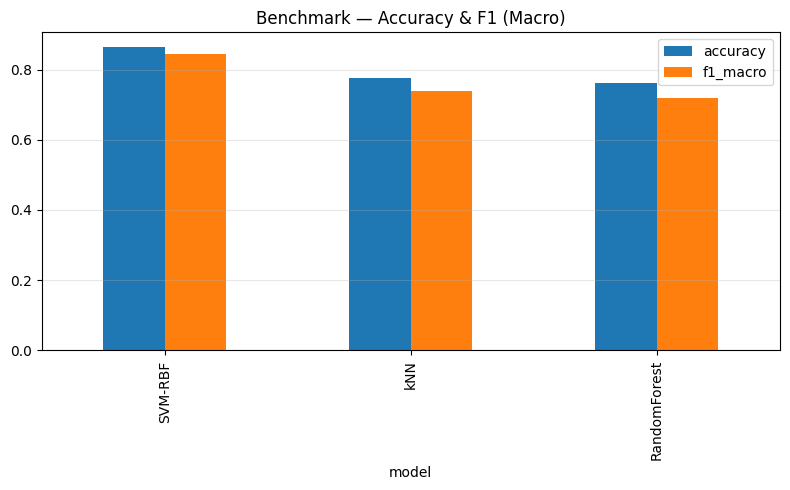

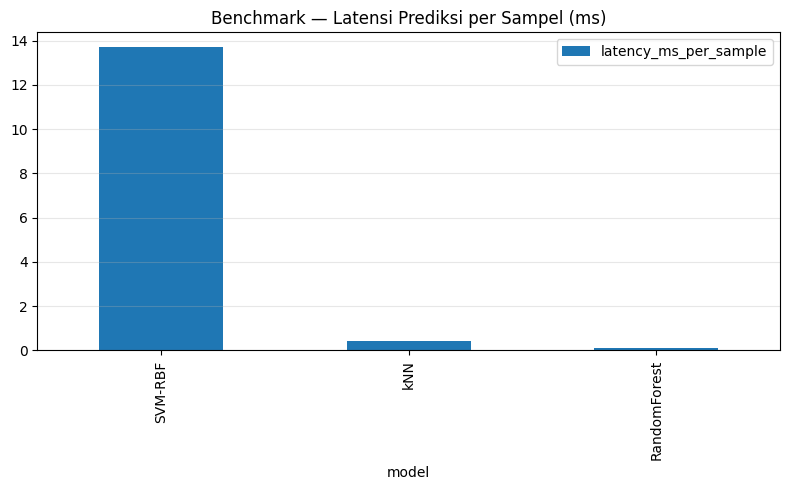

In [34]:
# SEL9 — Benchmark (Accuracy, Precision/Recall/F1 macro, mAP, ROC-AUC, latency, model size)
import time, os
from sklearn.preprocessing import label_binarize

def file_size_mb(p): 
    return os.path.getsize(p)/1024/1024 if (p and os.path.exists(p)) else np.nan

def bench_model(name, clf, X, y, proba_fn, joblib_path=None, repeat=3):
    yhat = clf.predict(X)
    acc = accuracy_score(y, yhat)
    p,r,f1,_ = precision_recall_fscore_support(y, yhat, average="macro", zero_division=0)
    # pred latency (fastest of N repeats)
    tmin = float("inf")
    for _ in range(repeat):
        t0 = time.time(); _ = clf.predict(X); dt = time.time()-t0; tmin = min(tmin, dt)
    latency_ms = (tmin/len(X))*1000.0
    # probability metrics
    proba = proba_fn(clf, X)
    mAP = roc = np.nan
    try:
        Ybin = label_binarize(y, classes=[0,1,2])
        mAP = average_precision_score(Ybin, proba, average="macro")
        roc = roc_auc_score(Ybin, proba, average="macro", multi_class="ovr")
    except Exception:
        pass
    return {"model":name, "accuracy":acc, "precision_macro":p, "recall_macro":r, "f1_macro":f1,
            "mAP_macro":mAP, "roc_auc_macro":roc, "latency_ms_per_sample":latency_ms,
            "model_size_mb": file_size_mb(joblib_path)}

bench = []
bench.append(bench_model("SVM-RBF", svm, Xte, y_te, safe_proba, str(clf_dir/"svm_rbf.joblib")))
bench.append(bench_model("RandomForest", rf, Xte, y_te, safe_proba, str(clf_dir/"random_forest.joblib")))
bench.append(bench_model("kNN", knn, Xte, y_te, safe_proba, str(clf_dir/"knn.joblib")))

df_bench = pd.DataFrame(bench).sort_values("f1_macro", ascending=False)
display(df_bench)
bench_csv = VIZ_STAGE4/f"benchmark_models_{ts}.csv"
df_bench.to_csv(bench_csv, index=False); print("🗒️ Saved:", bench_csv)

ax = df_bench.set_index("model")[["accuracy","f1_macro"]].plot(kind="bar", figsize=(8,5))
ax.set_title("Benchmark — Accuracy & F1 (Macro)"); ax.grid(axis="y", alpha=0.3)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"benchmark_acc_f1_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

ax = df_bench.set_index("model")[["latency_ms_per_sample"]].plot(kind="bar", figsize=(8,5))
ax.set_title("Benchmark — Latensi Prediksi per Sampel (ms)"); ax.grid(axis="y", alpha=0.3)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"benchmark_latency_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()


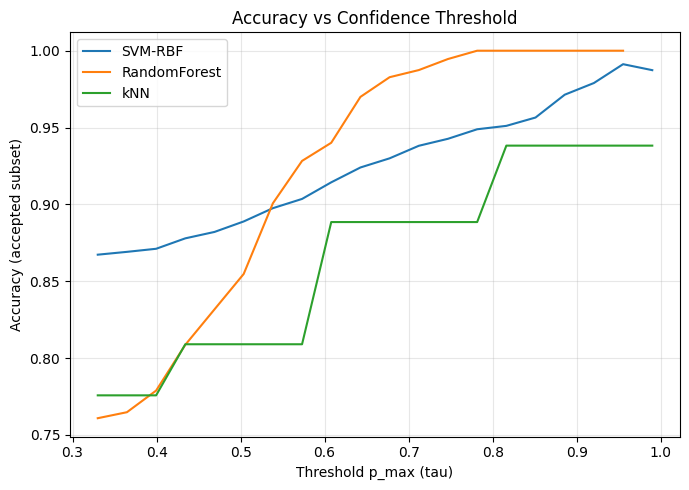

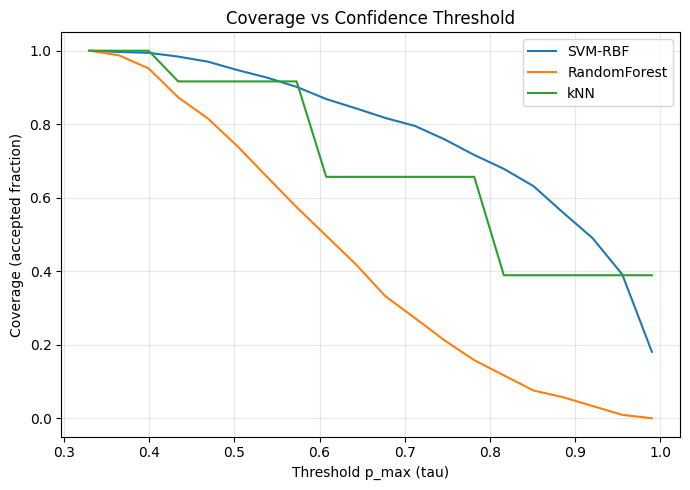

In [35]:
# SEL10 — Accuracy vs Confidence Threshold (coverage juga)
def acc_at_threshold(model, X, y, taus=np.linspace(0.33, 0.99, 20)):
    proba = safe_proba(model, X); yhat = proba.argmax(axis=1); pmax = proba.max(axis=1)
    accs, covs = [], []
    for t in taus:
        keep = pmax >= t
        covs.append(keep.mean())
        accs.append((yhat[keep]==y[keep]).mean() if keep.any() else np.nan)
    return pd.DataFrame({"tau":taus, "coverage":covs, "accuracy":accs})

df_cal_svm = acc_at_threshold(svm, Xte, y_te)
df_cal_rf  = acc_at_threshold(rf,  Xte, y_te)
df_cal_knn = acc_at_threshold(knn, Xte, y_te)

plt.figure(figsize=(7,5))
plt.plot(df_cal_svm.tau, df_cal_svm.accuracy, label="SVM-RBF")
plt.plot(df_cal_rf.tau,  df_cal_rf.accuracy,  label="RandomForest")
plt.plot(df_cal_knn.tau, df_cal_knn.accuracy, label="kNN")
plt.xlabel("Threshold p_max (tau)"); plt.ylabel("Accuracy (accepted subset)")
plt.title("Accuracy vs Confidence Threshold"); plt.legend(); plt.grid(True, alpha=0.3)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"confidence_threshold_accuracy_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()

plt.figure(figsize=(7,5))
plt.plot(df_cal_svm.tau, df_cal_svm.coverage, label="SVM-RBF")
plt.plot(df_cal_rf.tau,  df_cal_rf.coverage,  label="RandomForest")
plt.plot(df_cal_knn.tau, df_cal_knn.coverage, label="kNN")
plt.xlabel("Threshold p_max (tau)"); plt.ylabel("Coverage (accepted fraction)")
plt.title("Coverage vs Confidence Threshold"); plt.legend(); plt.grid(True, alpha=0.3)
plt.tight_layout(); plt.savefig(VIZ_STAGE4/f"confidence_threshold_coverage_{ts}.png", dpi=150, bbox_inches="tight"); plt.show()


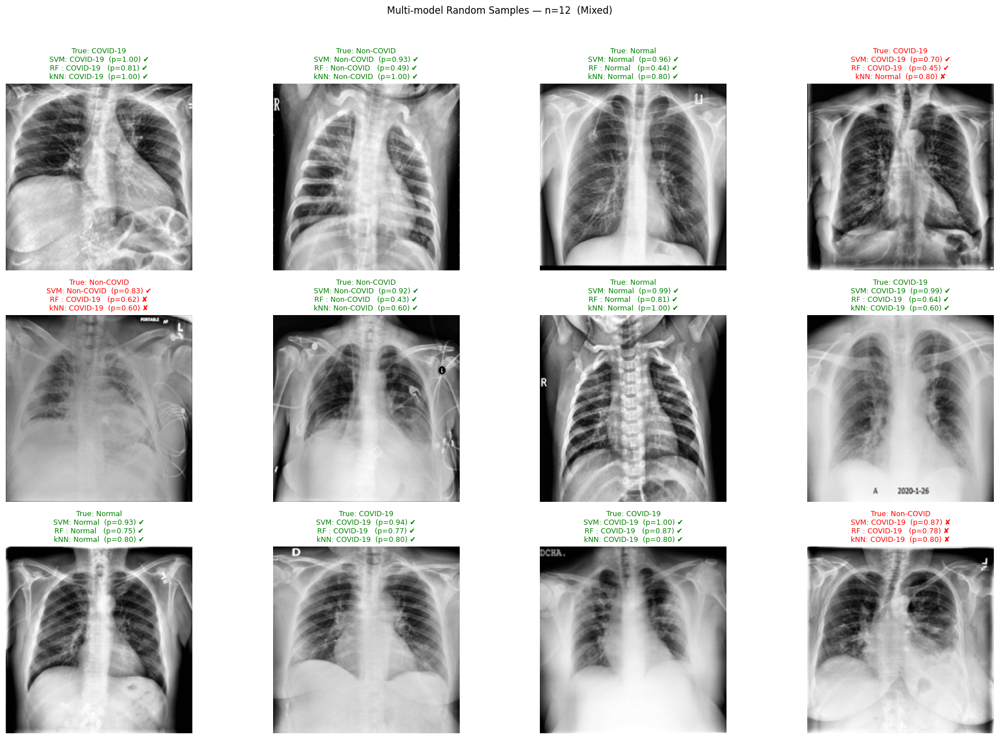

🖼️ Saved: artifacts/viz_stage4/multimodel_grid_mixed_12_20251104-033335.png
🗒️ Saved: artifacts/viz_stage4/multimodel_samples_mixed_12_20251104-033335.csv


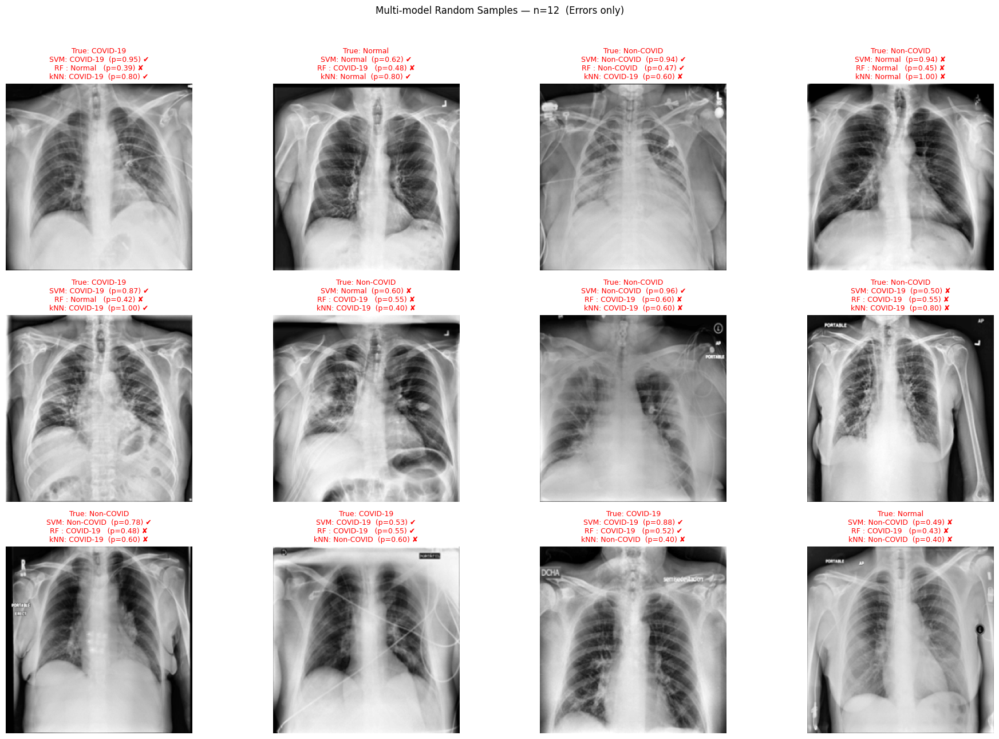

🖼️ Saved: artifacts/viz_stage4/multimodel_grid_errors_12_20251104-033335.png
🗒️ Saved: artifacts/viz_stage4/multimodel_samples_errors_12_20251104-033335.csv


In [36]:
# SEL13 (FIX) — Multi-model random sampling (gabung SVM/RF/kNN) + gambar + true/pred/confidence
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path
from datetime import datetime

# Pastikan folder simpan ada
try:
    VIZ_STAGE4
except NameError:
    VIZ_STAGE4 = Path("./artifacts/viz_stage4")
VIZ_STAGE4.mkdir(parents=True, exist_ok=True)

_ts = datetime.now().strftime("%Y%m%d-%H%M%S")

# 1) Gabungkan per-sample (index = path,true) → kolom per-model: pred, prob_max, is_correct
def build_combined_table(df_all: pd.DataFrame) -> pd.DataFrame:
    piv = df_all.pivot_table(
        index=["path", "true_id", "true"],
        columns="model",
        values=["pred", "prob_max", "is_correct"],
        aggfunc="first"
    )
    piv.columns = [f"{a}__{b}" for a,b in piv.columns.to_flat_index()]  # flatten
    piv = piv.reset_index()
    return piv

combined = build_combined_table(df_stage4_all)

# 2) Selector random (errors_only: minimal 1 model salah)
def select_random_samples(comb_df: pd.DataFrame, n=12, errors_only=False, seed=7):
    rng = np.random.RandomState(seed)
    df = comb_df.copy()
    if errors_only:
        corr_cols = [c for c in df.columns if c.startswith("is_correct__")]
        # True jika SEMUA benar; kita ambil negasinya (ada yang salah)
        all_correct = np.all(df[corr_cols].fillna(False).values, axis=1)
        df = df[~all_correct].copy()
    if len(df) == 0:
        raise ValueError("Tidak ada sampel yang cocok dengan filter.")
    take = min(n, len(df))
    idx = rng.choice(df.index.values, size=take, replace=False)
    return df.loc[idx].reset_index(drop=True)

def _okmark(x) -> str:
    # dukung NaN/None → "-"
    if x is None or (isinstance(x, float) and np.isnan(x)):
        return "-"
    return "✔" if bool(x) else "✘"

# 3) Plot grid semua model
def plot_multimodel_grid(df_all: pd.DataFrame, n=12, errors_only=False, seed=7, cols=4):
    samp = select_random_samples(combined, n=n, errors_only=errors_only, seed=seed)

    # map path test → posisi dalam array test_idx
    path_to_testpos = {p: i for i, p in enumerate(paths_te)}

    n_show = len(samp)
    cols = max(1, min(cols, n_show))
    rows = int(np.ceil(n_show / cols))
    plt.figure(figsize=(4.8*cols, 4.2*rows))

    for k, (_, row) in enumerate(samp.iterrows(), start=1):
        path = row["path"]
        pos = path_to_testpos.get(path, None)
        img = X[test_idx[pos]] if pos is not None else np.zeros_like(X[0])

        true_lbl = row["true"]

        # ambil field helper (pakai row.get agar aman)
        def f(base, model):
            return row.get(f"{base}__{model}", None)

        # SVM-RBF
        svm_pred = f("pred", "SVM-RBF")
        svm_pmax = f("prob_max", "SVM-RBF")
        svm_ok   = f("is_correct", "SVM-RBF")

        # RandomForest
        rf_pred = f("pred", "RandomForest")
        rf_pmax = f("prob_max", "RandomForest")
        rf_ok   = f("is_correct", "RandomForest")

        # kNN
        knn_pred = f("pred", "kNN")
        knn_pmax = f("prob_max", "kNN")
        knn_ok   = f("is_correct", "kNN")

        plt.subplot(rows, cols, k)
        plt.imshow(img, cmap="gray")
        plt.axis("off")

        def pfmt(p):
            if p is None or (isinstance(p, float) and np.isnan(p)): return "—"
            try: return f"{float(p):.2f}"
            except: return str(p)

        lines = [
            f"True: {true_lbl}",
            f"SVM: {svm_pred or '—'}  (p={pfmt(svm_pmax)}) {_okmark(svm_ok)}",
            f"RF : {rf_pred or '—'}   (p={pfmt(rf_pmax)}) {_okmark(rf_ok)}",
            f"kNN: {knn_pred or '—'}  (p={pfmt(knn_pmax)}) {_okmark(knn_ok)}",
        ]

        any_wrong = any([
            (svm_ok is not None and not bool(svm_ok)),
            (rf_ok  is not None and not bool(rf_ok)),
            (knn_ok is not None and not bool(knn_ok)),
        ])
        plt.title("\n".join(lines), fontsize=9, color=("red" if any_wrong else "green"))

    plt.suptitle(f"Multi-model Random Samples — n={n}  ({'Errors only' if errors_only else 'Mixed'})", y=1.02)
    plt.tight_layout()
    outp = VIZ_STAGE4 / f"multimodel_grid_{'errors' if errors_only else 'mixed'}_{n}_{_ts}.png"
    plt.savefig(outp, dpi=150, bbox_inches="tight")
    plt.show()
    print("🖼️ Saved:", outp)

    # Simpan tabel sampel
    csv_out = VIZ_STAGE4 / f"multimodel_samples_{'errors' if errors_only else 'mixed'}_{n}_{_ts}.csv"
    samp.to_csv(csv_out, index=False)
    print("🗒️ Saved:", csv_out)

# ------------ Contoh pemakaian ------------
# Campuran benar & salah
plot_multimodel_grid(df_stage4_all, n=12, errors_only=False, seed=11, cols=4)

# Hanya yang salah (setidaknya 1 model salah)
plot_multimodel_grid(df_stage4_all, n=12, errors_only=True,  seed=99, cols=4)
